In [1]:
import numpy as np
import os
import torch
import torch.nn as nn
import torch.nn.functional as F
import matplotlib.pyplot as plt
import imageio.v2 as imageio
import time

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


In [2]:
from scipy.spatial.transform import Rotation

In [3]:
def positional_encoding(x, num_frequencies=6, incl_input=True):


    results = []
    if incl_input:
        results.append(x)
    
    freq = torch.pow(2,torch.arange(num_frequencies)).to(device)
    sin_list = torch.sin(torch.pi*freq*x.reshape((-1,1))).to(device)
    cos_list  = torch.cos(torch.pi*freq*x.reshape((-1,1))).to(device)
    results.append(sin_list.reshape((x.shape[0],-1)))
    results.append(cos_list.reshape((x.shape[0],-1)))
    return torch.cat(results, dim=-1)


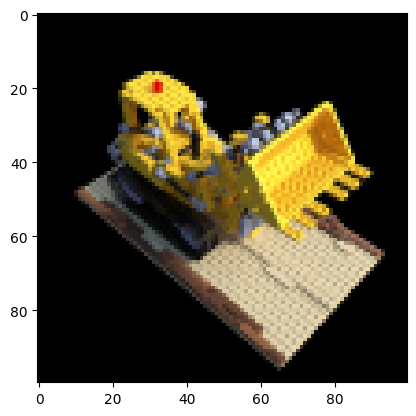

In [4]:

data = np.load("lego_data.npz")


images = data["images"]


height, width = images.shape[1:3]


poses = data["poses"]
poses = torch.from_numpy(poses).to(device)


intrinsics = data["intrinsics"]
intrinsics = torch.from_numpy(intrinsics).to(device)


test_image, test_pose = images[101], poses[101]
test_image = torch.from_numpy(test_image).to(device)


images = torch.from_numpy(images[:100, ..., :3]).to(device)

plt.imshow(test_image.detach().cpu().numpy())
plt.show()

In [5]:
def get_rays(height, width, intrinsics, w_R_c, w_T_c):

    device = intrinsics.device
    ray_directions = torch.zeros((height, width, 3), device=device)  
    ray_origins = torch.zeros((height, width, 3), device=device)  


    coords = torch.stack(torch.meshgrid(torch.arange(height), torch.arange(width), indexing='xy'), -1).reshape((-1,2))
    coords = torch.concat((coords, torch.ones(coords.shape[0],1)), -1).to(device)
    
    rays = w_R_c @ torch.linalg.inv(intrinsics) @ coords.T
    
    
    rays = rays/torch.norm(rays, dim=0)
    rays_directions = rays.T.reshape((height,width,3))
    rays_origins = torch.broadcast_to(w_T_c.T, ((height, width,3)))
    
    

    return rays_origins, rays_directions

In [6]:
def stratified_sampling(ray_origins, ray_directions, near, far, samples):


    i = torch.arange(samples)
    depth = near + (i/samples)*(far-near)
    depth = depth.to(device)
    ray_points = torch.unsqueeze(ray_origins, dim=3) + torch.unsqueeze(ray_directions, dim = 3) * depth
    ray_points = ray_points.permute(0,1,3,2)
    depth_points = torch.broadcast_to(depth, (ray_origins.shape[0], ray_origins.shape[1], samples))

    return ray_points, depth_points

In [7]:
class nerf_model(nn.Module):

    def __init__(self, filter_size=256, num_x_frequencies=6, num_d_frequencies=3):
        super().__init__()

 
        self.layers = nn.ModuleDict({
            'layer_1': nn.Linear(3*2*num_x_frequencies + 3, filter_size),
            'layer_2': nn.Linear(filter_size,filter_size),
            'layer_3': nn.Linear(filter_size,filter_size),
            'layer_4': nn.Linear(filter_size,filter_size),
            'layer_5': nn.Linear(filter_size,filter_size),
            'layer_6': nn.Linear(filter_size+3*2*num_x_frequencies + 3, filter_size),
            'layer_7': nn.Linear(filter_size,filter_size),
            'layer_8': nn.Linear(filter_size,filter_size),
            'layer_s': nn.Linear(filter_size,1),
            'layer_9': nn.Linear(filter_size,filter_size),
            'layer_10': nn.Linear(filter_size+3*2*num_d_frequencies + 3,filter_size//2),
            'layer_11': nn.Linear(filter_size//2, 3),
        })




    def forward(self, x, d):

        
        out = self.layers['layer_1'](x)
        out = F.relu(out)
        out = self.layers['layer_2'](out)
        out = F.relu(out)
        out = self.layers['layer_3'](out)
        out = F.relu(out)
        out = self.layers['layer_4'](out)
        out = F.relu(out)
        out = self.layers['layer_5'](out)
        out = F.relu(out)
        out = torch.concat([x,out], -1)
        out = self.layers['layer_6'](out)
        out = F.relu(out)
        out = self.layers['layer_7'](out)
        out = F.relu(out)
        out = self.layers['layer_8'](out)
        sigma = self.layers['layer_s'](out)
        sigma = F.relu(sigma)
        out = self.layers['layer_9'](out)
        out = F.relu(out)
        out = torch.concat([out, d], -1)
        out = self.layers['layer_10'](out)
        out = F.relu(out)
        out = self.layers['layer_11'](out)
        rgb = F.sigmoid(out)

        return rgb, sigma

In [8]:
def get_batches(ray_points, ray_directions, num_x_frequencies, num_d_frequencies):

    def get_chunks(inputs, chunksize = 2**15):
        
        return [inputs[i:i + chunksize] for i in range(0, inputs.shape[0], chunksize)]

    

    ray_directions = torch.unsqueeze(ray_directions, dim=2)
    ray_directions = torch.broadcast_to(ray_directions, ray_points.shape)
    
    
    embed_ray_dir = positional_encoding(ray_directions.reshape((-1,3)), num_frequencies=num_d_frequencies, incl_input=True)
    embed_ray_point = positional_encoding(ray_points.reshape((-1,3)), num_frequencies=num_x_frequencies, incl_input=True)
    ray_points_batches = get_chunks(embed_ray_point)
    ray_directions_batches = get_chunks(embed_ray_dir)
    
    
    
    


    return ray_points_batches, ray_directions_batches

In [9]:
def volumetric_rendering(rgb, s, depth_points):


    delta = depth_points[...,1:]  - depth_points[...,:-1]
    delta = torch.concat([delta, torch.ones((delta.shape[0], delta.shape[1], 1)).to(device)*1e9], -1) 
    inter_Ti = torch.exp(-s*delta)
    Ti = torch.concat([torch.ones((delta.shape[0], delta.shape[1], 1)).to(device),torch.cumprod(inter_Ti, dim=-1)[:,:,:-1]], -1)

    c = torch.unsqueeze(Ti, dim=-1) * (1-torch.unsqueeze(inter_Ti, dim=-1)) * rgb
    rec_image = torch.sum(c, dim=2)



    return rec_image

In [10]:
def one_forward_pass(height, width, intrinsics, w_R_c, w_T_c, near, far, samples, model, num_x_frequencies, num_d_frequencies):



    

    
    
    
    
    ray_o, ray_d = get_rays(height, width, intrinsics, w_R_c.reshape((3,3)), w_T_c.reshape((3,1)))

    
    ray_points, depth_points = stratified_sampling(ray_o, ray_d, near, far, samples)

    
    ray_points_batches, ray_directions_batches = get_batches(ray_points, ray_d, num_x_frequencies, num_d_frequencies)
    rgb_list = []
    sigma_list =[]
    
    for batch_i in range(len(ray_points_batches)):
      
      rgb, sigma = model(ray_points_batches[batch_i], ray_directions_batches[batch_i])
      rgb_list.append(rgb)
      sigma_list.append(sigma)
      
    rec_image = volumetric_rendering(torch.concat(rgb_list, 0).reshape((height, width,samples, 3)), torch.concat(sigma_list,0).reshape((height, width, samples)), depth_points)


    return rec_image

In [11]:
num_x_frequencies = 10
num_d_frequencies = 4
learning_rate  = 5e-4
iterations = 3000
samples = 64
display = 25
near = 0.667
far = 2

model = nerf_model(num_x_frequencies=num_x_frequencies,num_d_frequencies=num_d_frequencies).to(device)

def weights_init(m):
    if isinstance(m, torch.nn.Linear):
        torch.nn.init.xavier_uniform_(m.weight)
model.apply(weights_init)

optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

psnrs = []
iternums = []

t = time.time()
t0 = time.time()

In [12]:
criterion = torch.nn.MSELoss()

In [13]:
poses = torch.Tensor(poses)
poses.shape

torch.Size([106, 4, 4])

In [14]:
w_T_c_all = poses[:,:3,-1]
w_T_c_all.shape

torch.Size([106, 3])

In [15]:
w_R_c_all = poses[:,:3,:3]
w_R_c_all.shape

torch.Size([106, 3, 3])

In [17]:
r = Rotation.from_matrix(w_R_c_all.cpu())
euler_angles_all_orig = torch.Tensor(r.as_euler('xyz', degrees = False))
euler_angles_all_orig.shape

torch.Size([106, 3])

In [18]:
euler_angles_all_orig[0,...]

tensor([-1.8752e+00, -5.8094e-10, -3.1276e+00])

In [19]:

noise = torch.randn_like(euler_angles_all_orig)
euler_angles_all = euler_angles_all_orig + 1*noise
euler_angles_all.shape, euler_angles_all[0,...]

(torch.Size([106, 3]), tensor([-1.5253, -0.1898, -3.2193]))

In [20]:
r =  Rotation.from_euler('xyz', euler_angles_all, degrees=False)
w_R_c_all_perturb = torch.from_numpy(r.as_matrix()).float().to(device)



w_R_c_all_perturb[0].shape, w_R_c_all_perturb[0]

(torch.Size([3, 3]),
 tensor([[-0.9791, -0.1914, -0.0690],
         [ 0.0763, -0.0307, -0.9966],
         [ 0.1887, -0.9810,  0.0446]], device='cuda:0'))

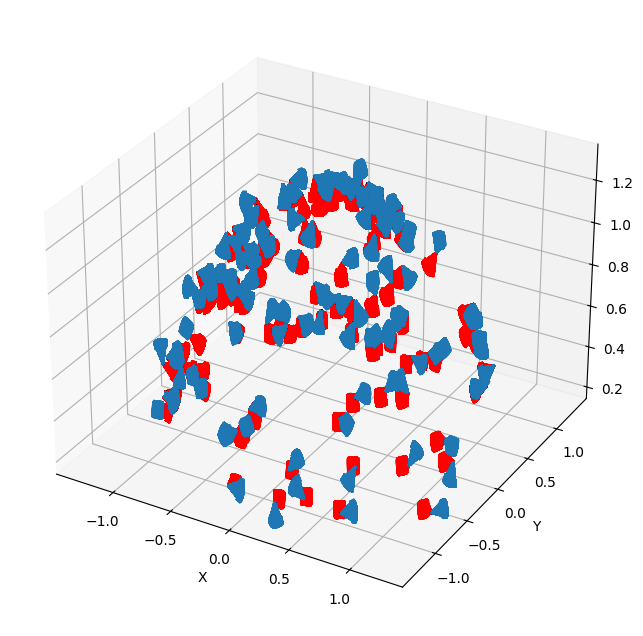

In [21]:
def plot_all_poses(poses, w_R_c_all_perturb, w_T_c_all):


    poses = torch.Tensor(poses).to(device)
    
    w_R_c = poses[:,:3,:3]
    w_T_c = poses[:,:3,3]
    origins = torch.zeros((poses.shape[0],height, width, 3))
    directions = torch.zeros((poses.shape[0],height, width, 3))
    for i in range(poses.shape[0]):
      ray_o, ray_d = get_rays(height, width, intrinsics, w_R_c[i,...].reshape((3,3)), w_T_c[i,...].reshape((3,1)))
      origins[i] = ray_o.to('cpu')
      directions[i] = ray_d.to('cpu')
      
      
    


    ax = plt.figure(figsize=(12, 8)).add_subplot(projection='3d')
    _ = ax.quiver(origins[..., 0].flatten(),
                  origins[..., 1].flatten(),
                  origins[..., 2].flatten(),
                  directions[..., 0].flatten(),
                  directions[..., 1].flatten(),
                  directions[..., 2].flatten(), length=0.12, normalize=True, color='red')
    
    w_R_c = w_R_c_all_perturb
    w_T_c = w_T_c_all
    origins = torch.zeros((poses.shape[0],height, width, 3))
    directions = torch.zeros((poses.shape[0],height, width, 3))
    for i in range(poses.shape[0]):
      ray_o, ray_d = get_rays(height, width, intrinsics, w_R_c[i,...].reshape((3,3)), w_T_c[i,...].reshape((3,1)))
      origins[i] = ray_o.to('cpu')
      directions[i] = ray_d.to('cpu')
      
      
    


    _ = ax.quiver(origins[..., 0].flatten(),
                  origins[..., 1].flatten(),
                  origins[..., 2].flatten(),
                  directions[..., 0].flatten(),
                  directions[..., 1].flatten(),
                  directions[..., 2].flatten(), length=0.12, normalize=True)
  
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('z')
    plt.show()

plot_all_poses(data['poses'], w_R_c_all_perturb, w_T_c_all)

In [22]:

test_pose_w_R_c = test_pose[:3,:3]
test_pose_w_T_c = test_pose[:3, 3]

In [23]:
mse_euler_error_list = []
loss_list = []
psnr_list = []

In [24]:
lr_rotation = 0.1

In [25]:
running_mse_euler_error = 0
running_loss = 0
running_psnr = 0

Iteration 0  Loss: 0.1512  PSNR: 8.20  Time: 10.56 secs per iter,  4.40 mins in total
The rotation error as compared to GT Rotation : 1.0742475986480713


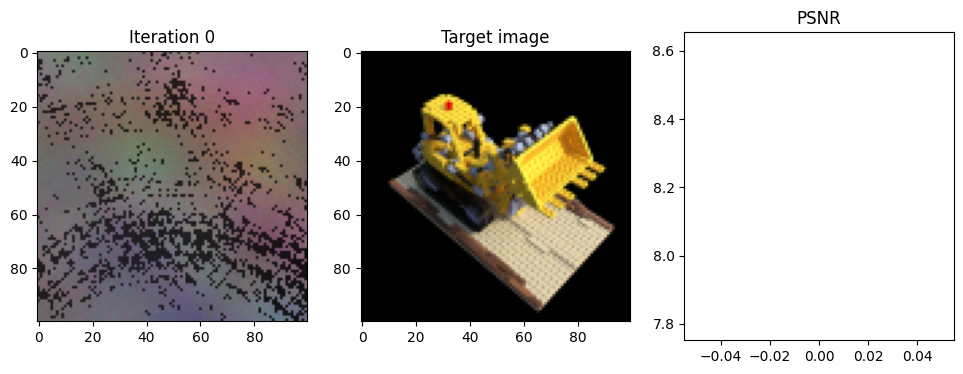

Iteration 25  Loss: 0.0843  PSNR: 10.74  Time: 0.33 secs per iter,  4.54 mins in total
The rotation error as compared to GT Rotation : 1.1174507188796996


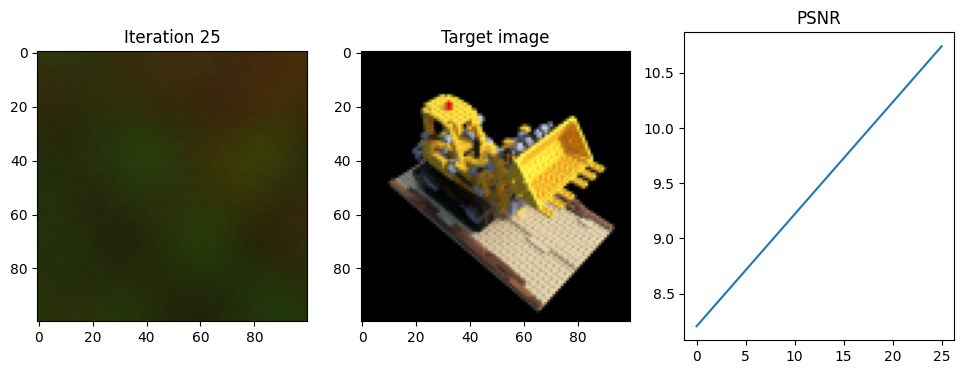

Iteration 50  Loss: 0.0874  PSNR: 10.58  Time: 0.33 secs per iter,  4.68 mins in total
The rotation error as compared to GT Rotation : 1.0746272706985474


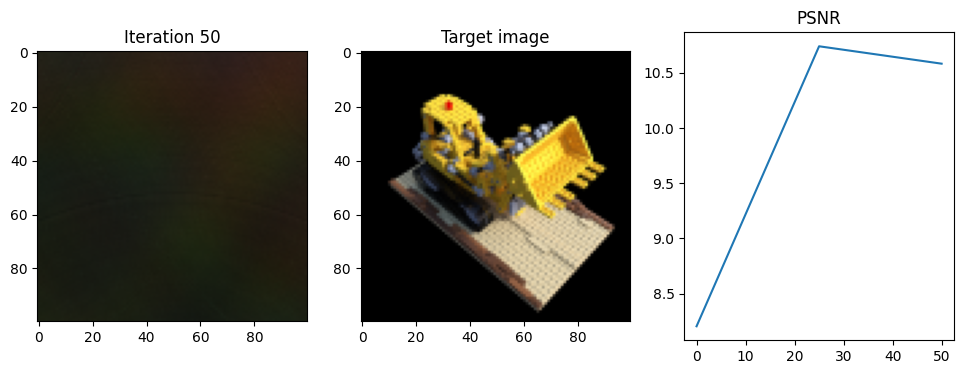

Iteration 75  Loss: 0.0864  PSNR: 10.64  Time: 0.33 secs per iter,  4.82 mins in total
The rotation error as compared to GT Rotation : 1.0746942234039307


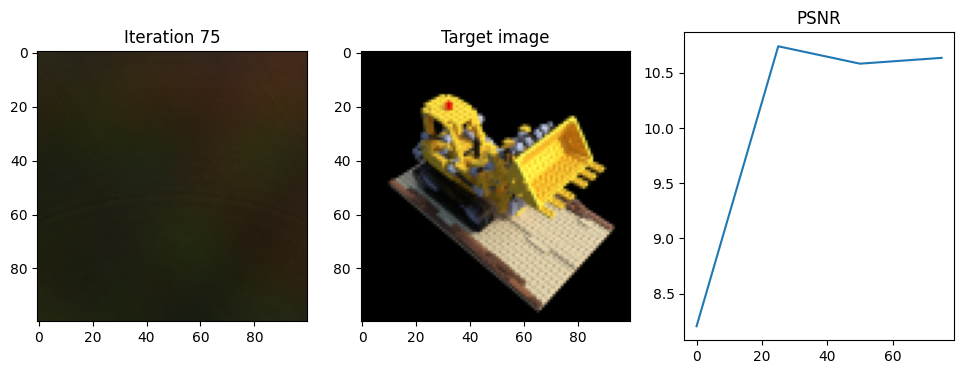

Iteration 100  Loss: 0.0879  PSNR: 10.56  Time: 0.33 secs per iter,  4.96 mins in total
The rotation error as compared to GT Rotation : 1.074704933166504


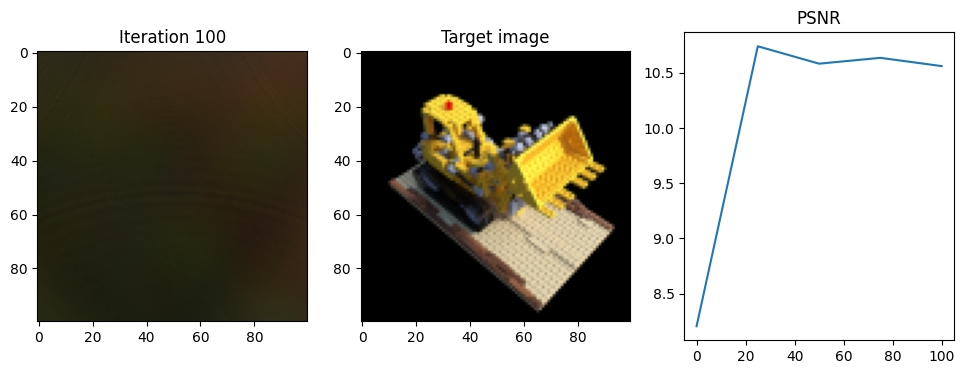

Iteration 125  Loss: 0.0933  PSNR: 10.30  Time: 0.33 secs per iter,  5.09 mins in total
The rotation error as compared to GT Rotation : 1.0746289205551147


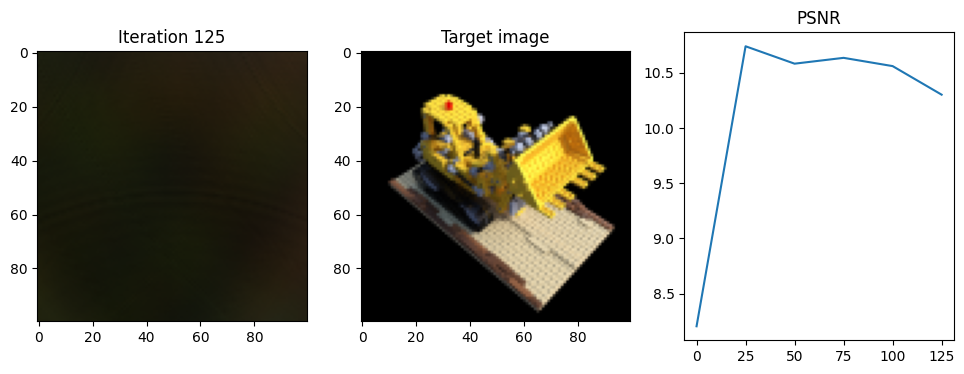

Iteration 150  Loss: 0.0898  PSNR: 10.47  Time: 0.33 secs per iter,  5.23 mins in total
The rotation error as compared to GT Rotation : 1.074623122215271


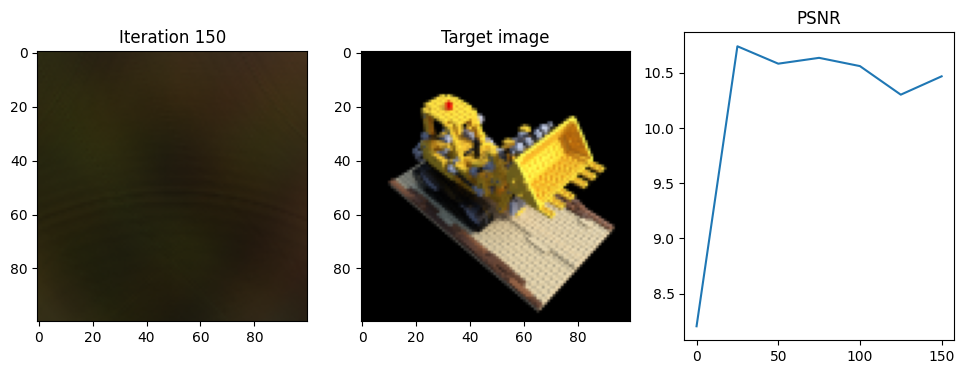

Iteration 175  Loss: 0.0936  PSNR: 10.29  Time: 0.33 secs per iter,  5.37 mins in total
The rotation error as compared to GT Rotation : 1.0746416807174684


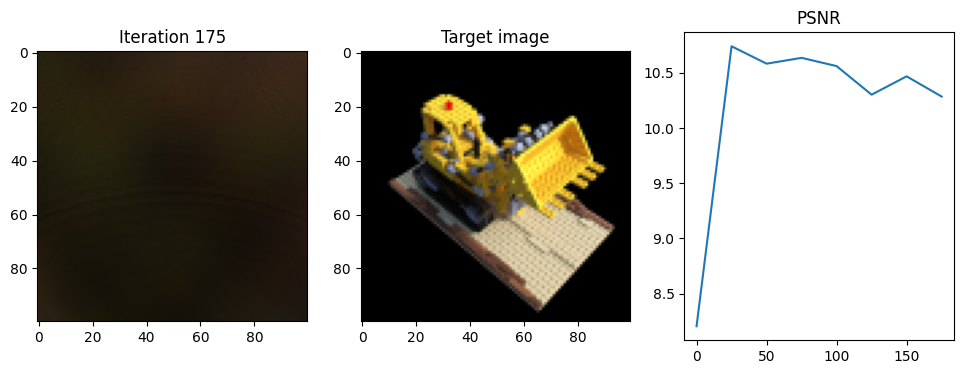

Iteration 200  Loss: 0.0914  PSNR: 10.39  Time: 0.33 secs per iter,  5.51 mins in total
The rotation error as compared to GT Rotation : 1.0746144914627076


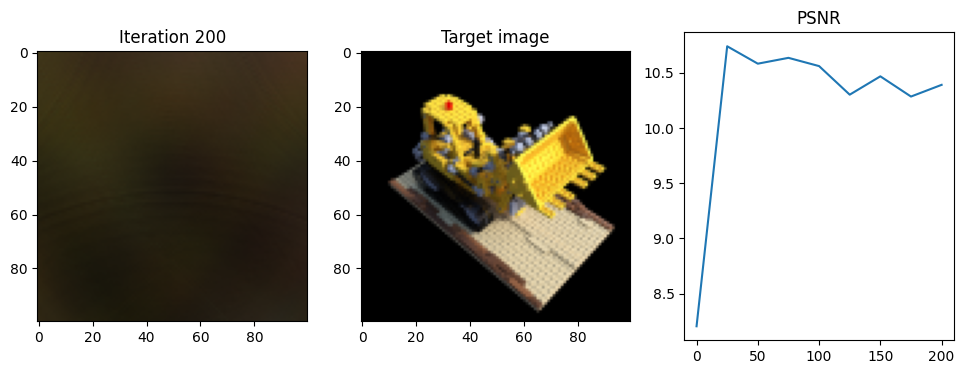

Iteration 225  Loss: 0.0904  PSNR: 10.44  Time: 0.33 secs per iter,  5.65 mins in total
The rotation error as compared to GT Rotation : 1.0746359968185424


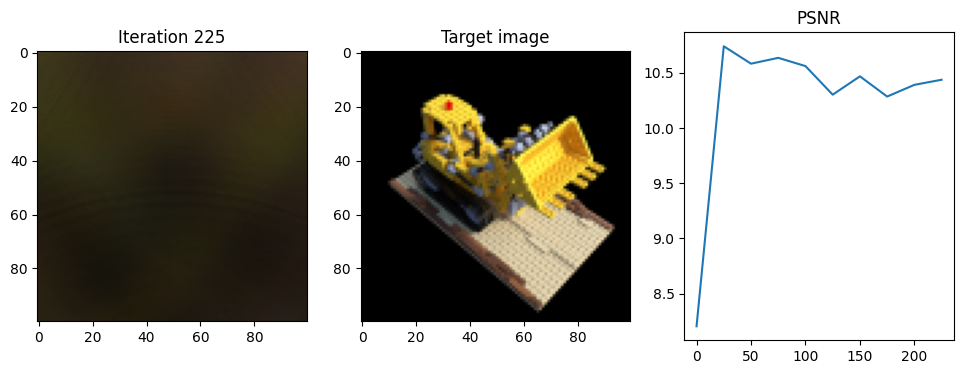

Iteration 250  Loss: 0.0956  PSNR: 10.20  Time: 0.33 secs per iter,  5.79 mins in total
The rotation error as compared to GT Rotation : 1.074642424583435


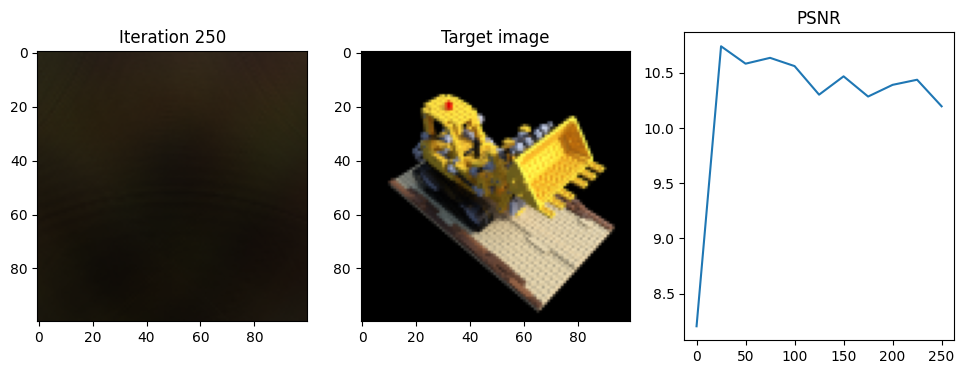

Iteration 275  Loss: 0.0903  PSNR: 10.44  Time: 0.33 secs per iter,  5.93 mins in total
The rotation error as compared to GT Rotation : 1.0746743059158326


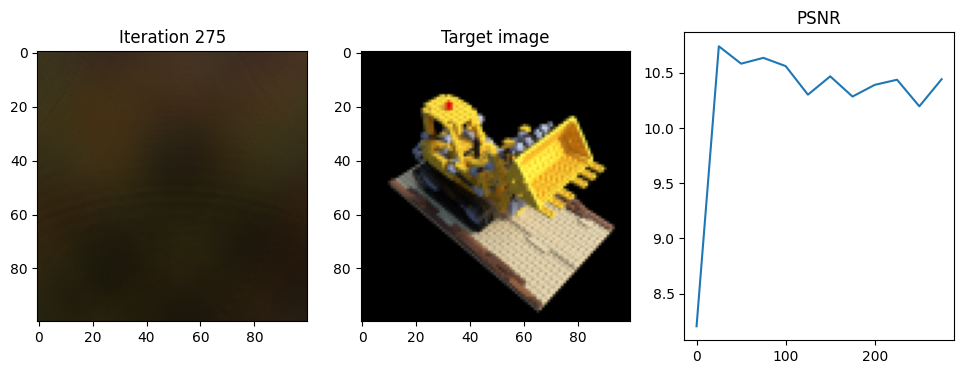

Iteration 300  Loss: 0.0903  PSNR: 10.44  Time: 0.33 secs per iter,  6.07 mins in total
The rotation error as compared to GT Rotation : 1.0746398591995239


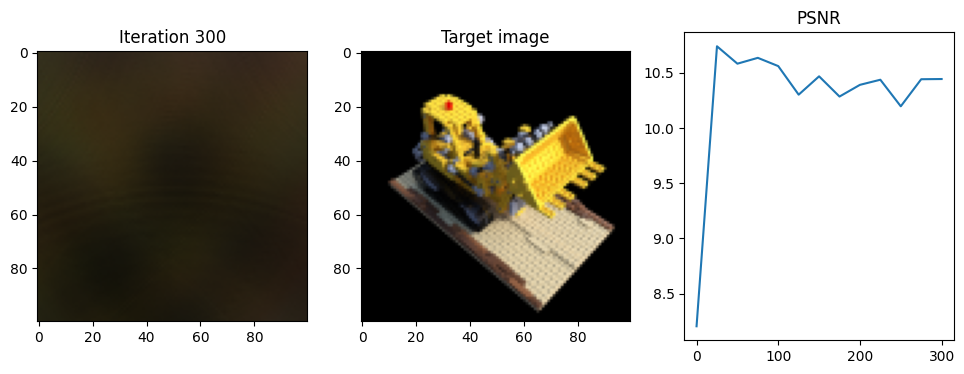

Iteration 325  Loss: 0.0915  PSNR: 10.39  Time: 0.33 secs per iter,  6.21 mins in total
The rotation error as compared to GT Rotation : 1.0746938753128052


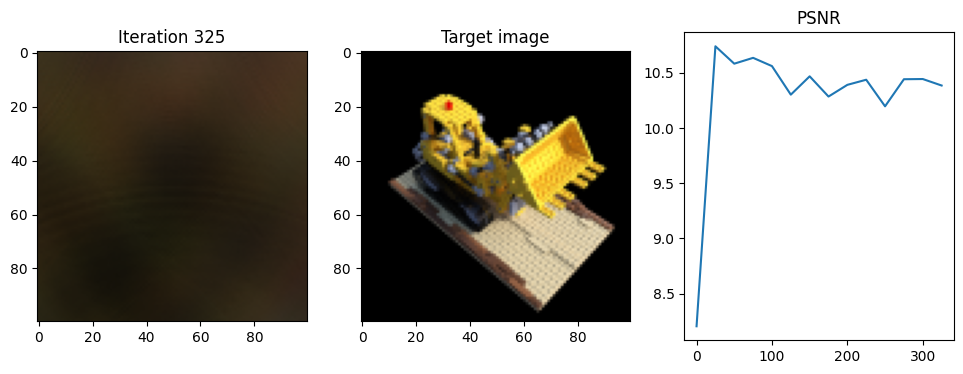

Iteration 350  Loss: 0.0932  PSNR: 10.31  Time: 0.33 secs per iter,  6.35 mins in total
The rotation error as compared to GT Rotation : 1.0747204732894897


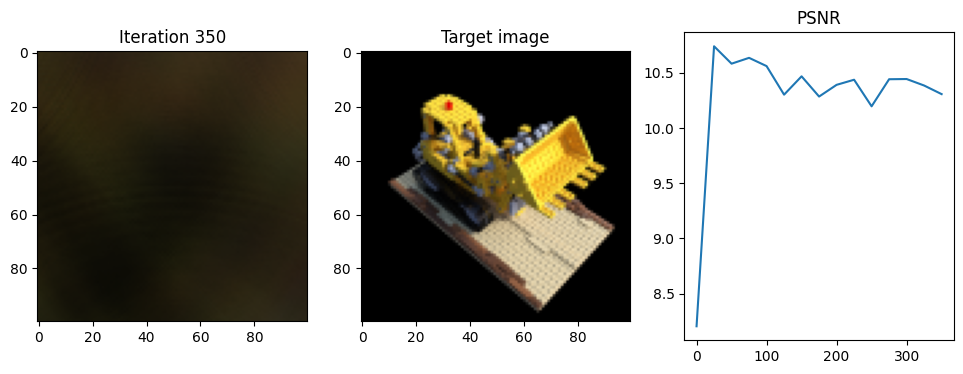

Iteration 375  Loss: 0.0892  PSNR: 10.49  Time: 0.33 secs per iter,  6.48 mins in total
The rotation error as compared to GT Rotation : 1.0747685956954955


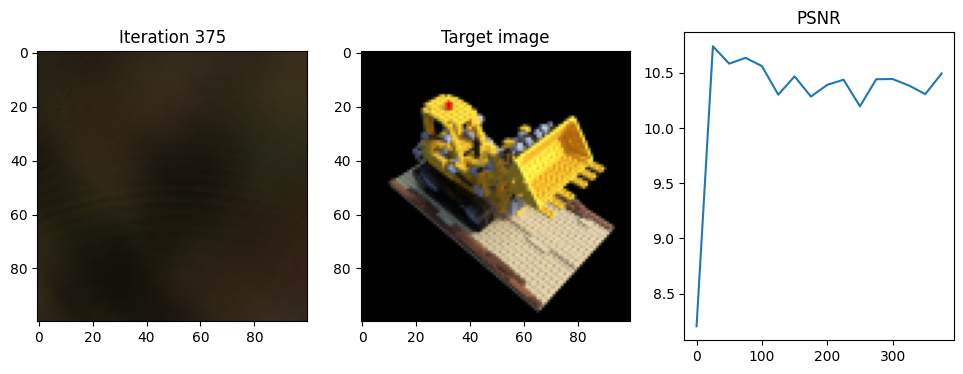

Iteration 400  Loss: 0.0843  PSNR: 10.74  Time: 0.33 secs per iter,  6.62 mins in total
The rotation error as compared to GT Rotation : 1.0749547815322875


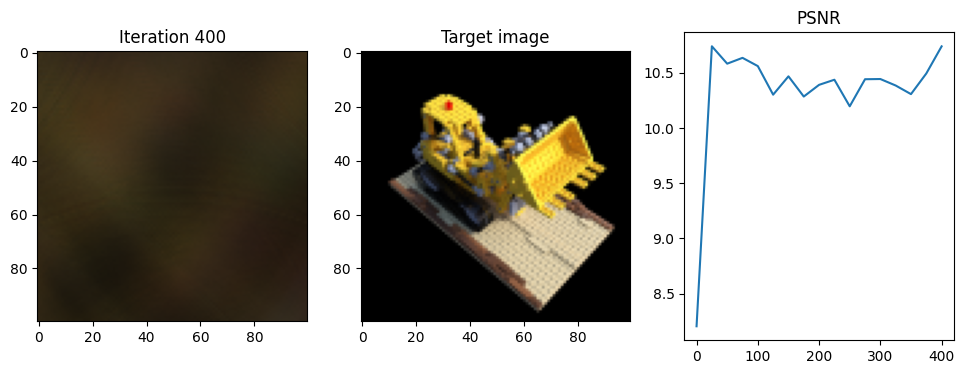

Iteration 425  Loss: 0.0845  PSNR: 10.73  Time: 0.33 secs per iter,  6.76 mins in total
The rotation error as compared to GT Rotation : 1.0749938011169433


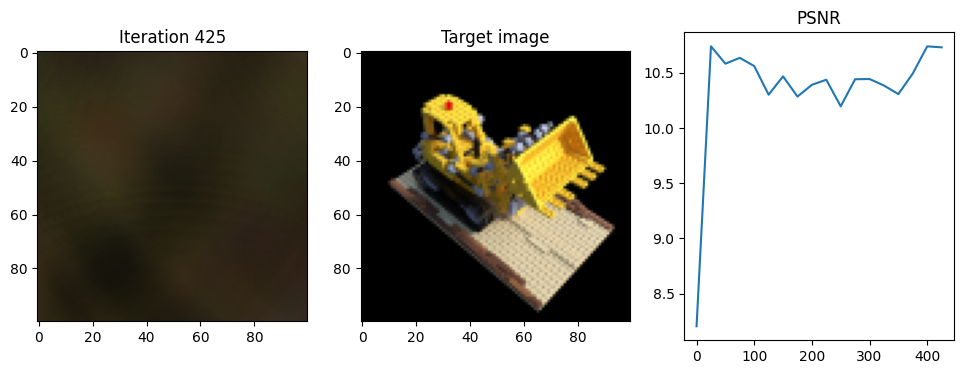

Iteration 450  Loss: 0.0901  PSNR: 10.45  Time: 0.33 secs per iter,  6.90 mins in total
The rotation error as compared to GT Rotation : 1.07503116607666


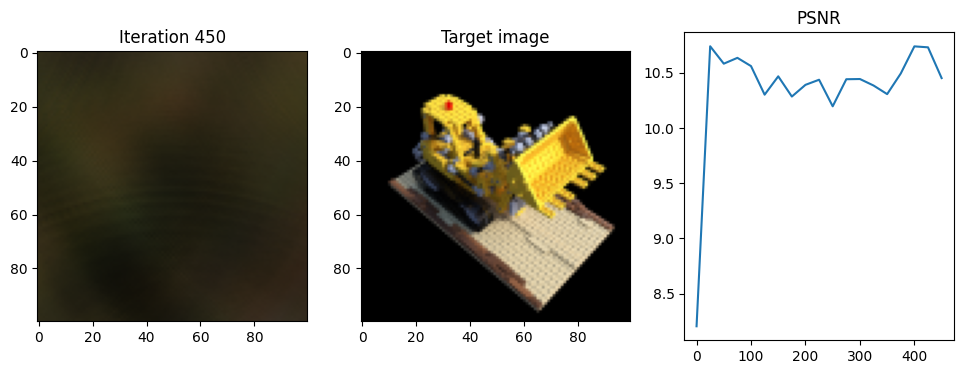

Iteration 475  Loss: 0.0962  PSNR: 10.17  Time: 0.33 secs per iter,  7.04 mins in total
The rotation error as compared to GT Rotation : 1.0749905586242676


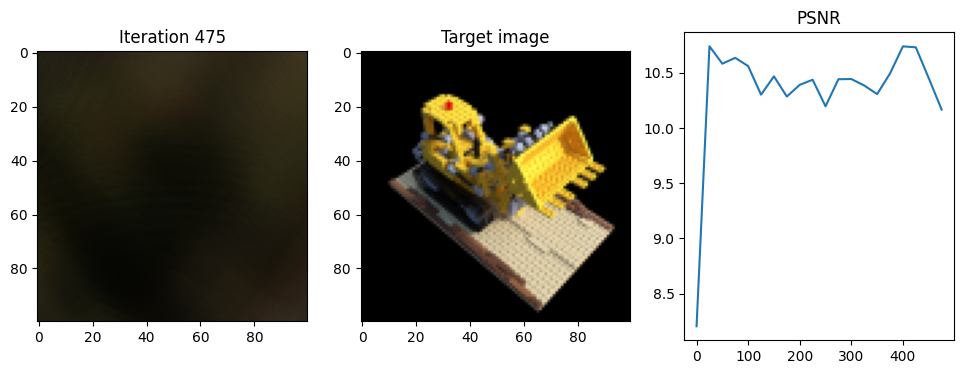

Iteration 500  Loss: 0.1028  PSNR: 9.88  Time: 0.33 secs per iter,  7.18 mins in total
The rotation error as compared to GT Rotation : 1.0749922180175782


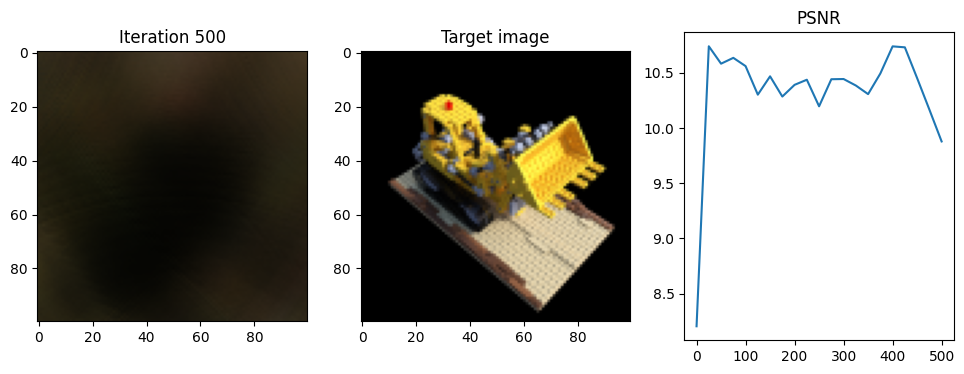

Iteration 525  Loss: 0.0987  PSNR: 10.06  Time: 0.33 secs per iter,  7.32 mins in total
The rotation error as compared to GT Rotation : 1.0749841165542602


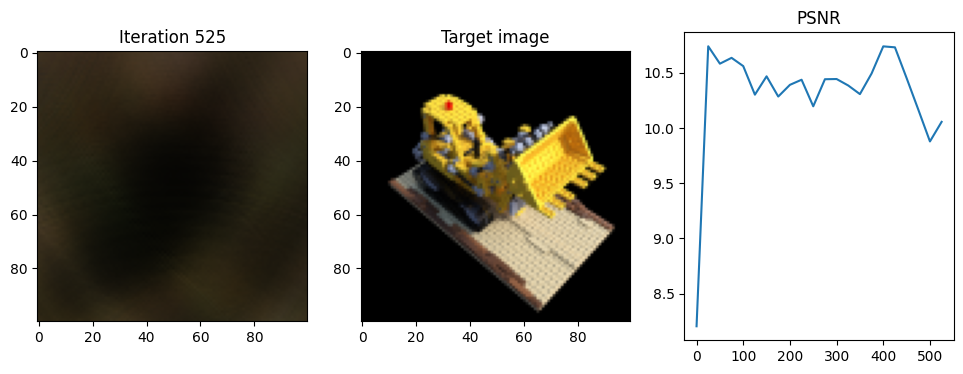

Iteration 550  Loss: 0.0926  PSNR: 10.33  Time: 0.42 secs per iter,  7.49 mins in total
The rotation error as compared to GT Rotation : 1.0749730730056763


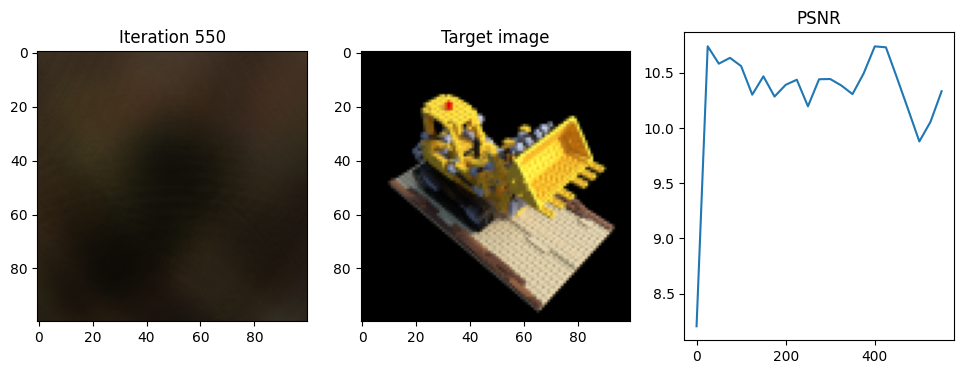

Iteration 575  Loss: 0.0967  PSNR: 10.15  Time: 0.33 secs per iter,  7.63 mins in total
The rotation error as compared to GT Rotation : 1.0749867296218871


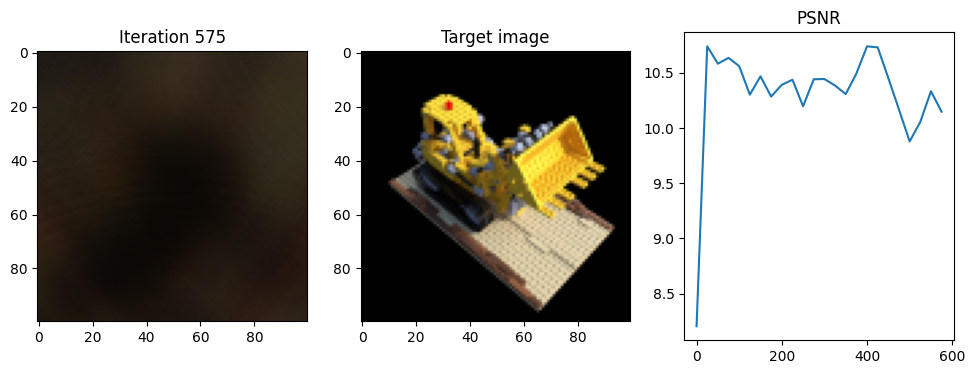

Iteration 600  Loss: 0.0934  PSNR: 10.29  Time: 0.33 secs per iter,  7.77 mins in total
The rotation error as compared to GT Rotation : 1.07499240398407


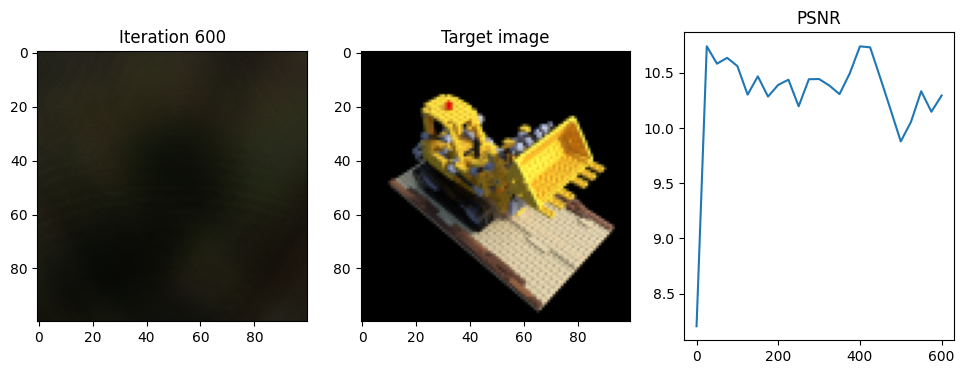

Iteration 625  Loss: 0.0938  PSNR: 10.28  Time: 0.33 secs per iter,  7.91 mins in total
The rotation error as compared to GT Rotation : 1.0750044393539429


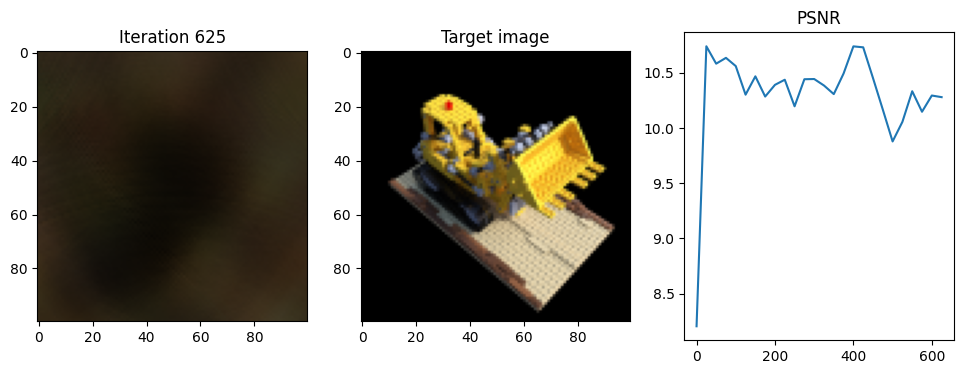

Iteration 650  Loss: 0.0894  PSNR: 10.49  Time: 0.33 secs per iter,  8.05 mins in total
The rotation error as compared to GT Rotation : 1.0749914455413818


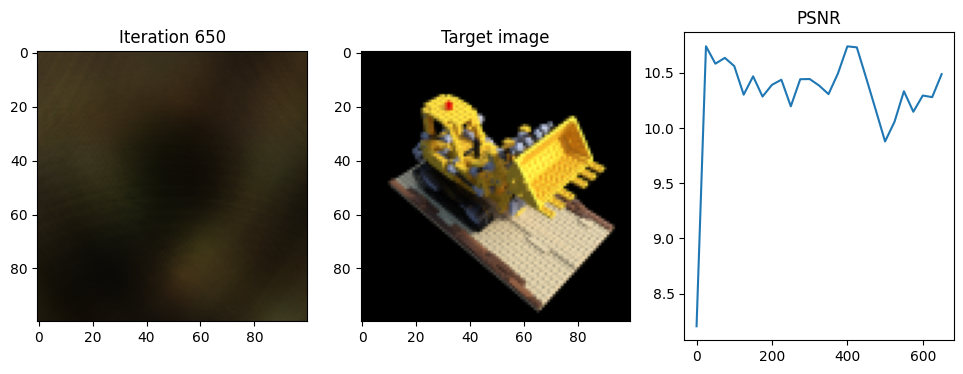

Iteration 675  Loss: 0.0947  PSNR: 10.24  Time: 0.33 secs per iter,  8.19 mins in total
The rotation error as compared to GT Rotation : 1.0749517679214478


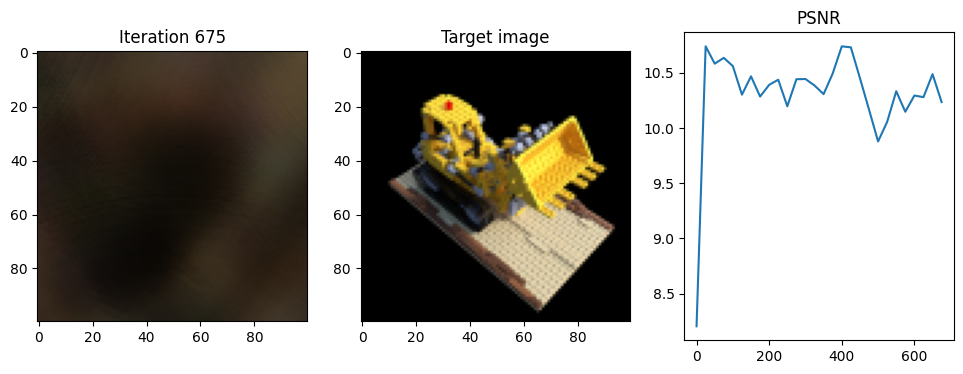

Iteration 700  Loss: 0.0970  PSNR: 10.13  Time: 0.33 secs per iter,  8.33 mins in total
The rotation error as compared to GT Rotation : 1.0749622631072997


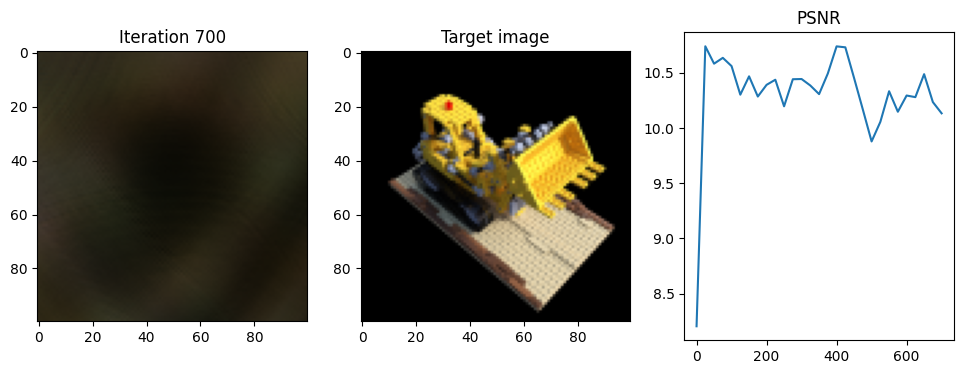

Iteration 725  Loss: 0.0979  PSNR: 10.09  Time: 0.33 secs per iter,  8.47 mins in total
The rotation error as compared to GT Rotation : 1.0749752378463746


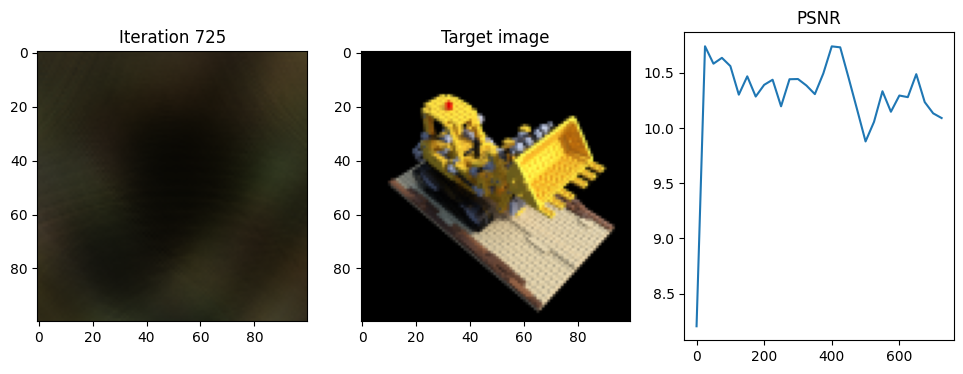

Iteration 750  Loss: 0.1044  PSNR: 9.81  Time: 0.34 secs per iter,  8.61 mins in total
The rotation error as compared to GT Rotation : 1.0750149488449097


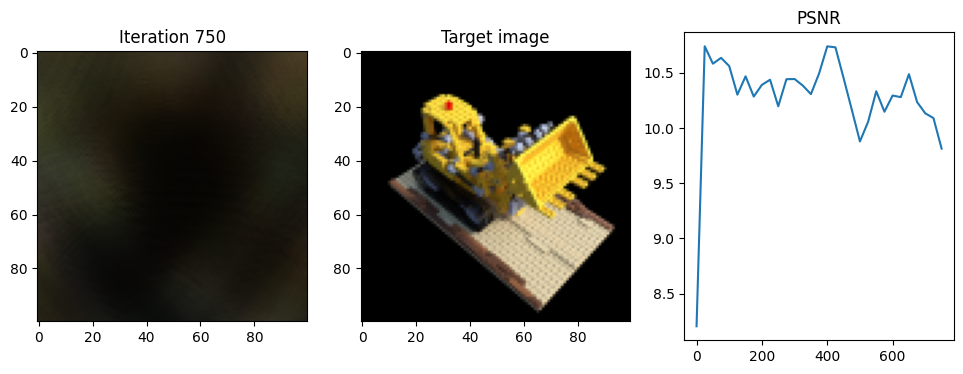

Iteration 775  Loss: 0.0925  PSNR: 10.34  Time: 0.33 secs per iter,  8.74 mins in total
The rotation error as compared to GT Rotation : 1.0750195980072021


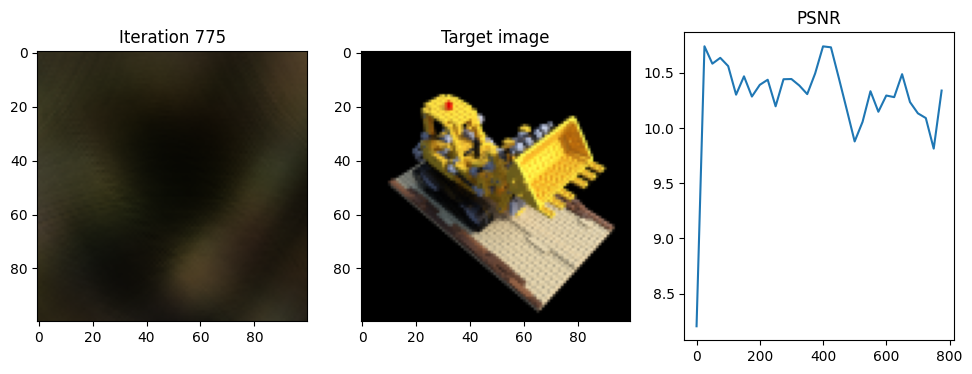

Iteration 800  Loss: 0.0963  PSNR: 10.16  Time: 0.33 secs per iter,  8.88 mins in total
The rotation error as compared to GT Rotation : 1.0750182962417603


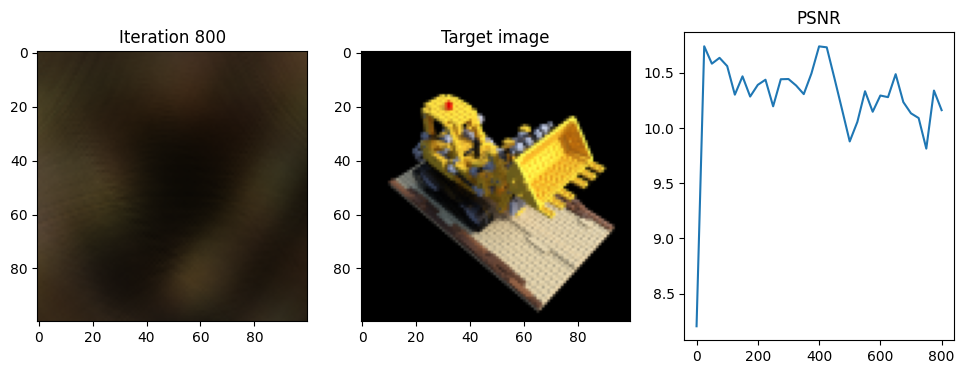

Iteration 825  Loss: 0.0860  PSNR: 10.66  Time: 0.33 secs per iter,  9.02 mins in total
The rotation error as compared to GT Rotation : 1.0750259113311769


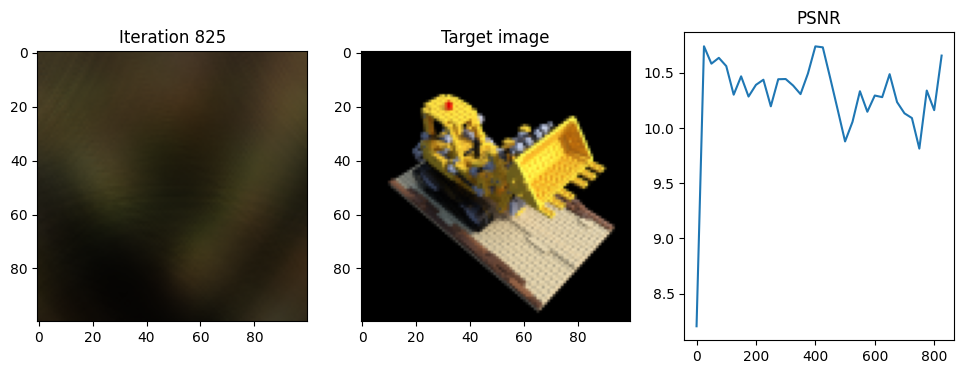

Iteration 850  Loss: 0.0910  PSNR: 10.41  Time: 0.33 secs per iter,  9.16 mins in total
The rotation error as compared to GT Rotation : 1.0750104188919067


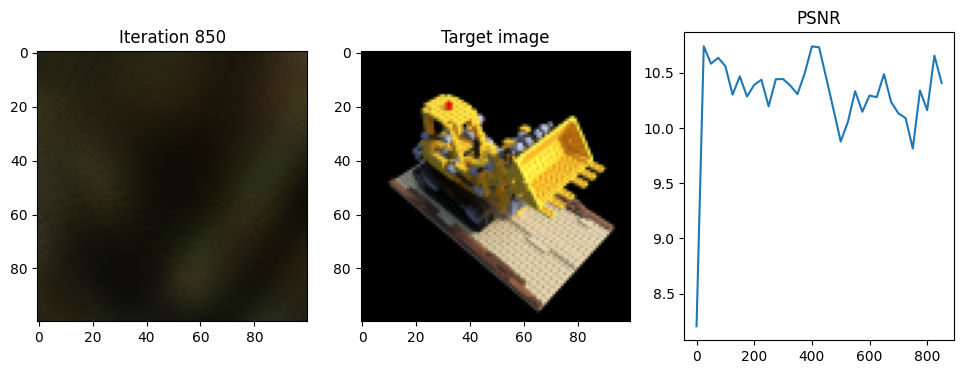

Iteration 875  Loss: 0.1000  PSNR: 10.00  Time: 0.33 secs per iter,  9.30 mins in total
The rotation error as compared to GT Rotation : 1.0750211000442504


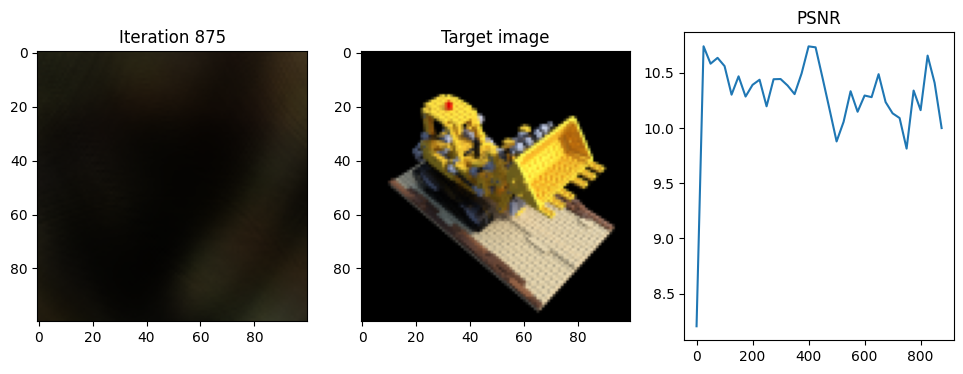

Iteration 900  Loss: 0.0884  PSNR: 10.53  Time: 0.33 secs per iter,  9.44 mins in total
The rotation error as compared to GT Rotation : 1.0750445699691773


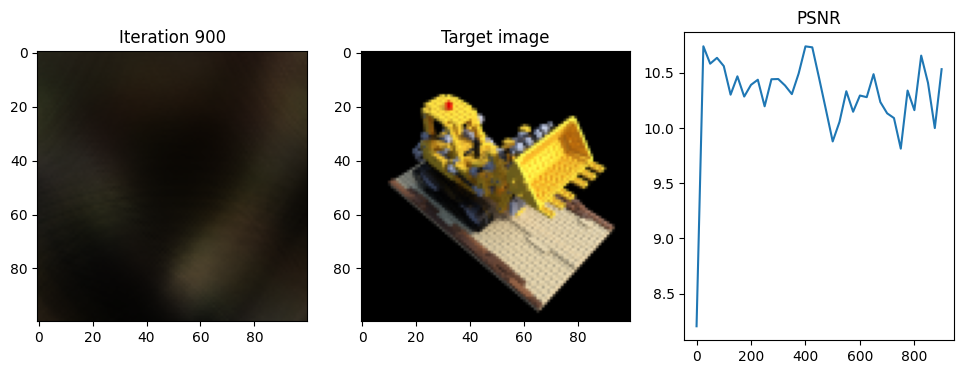

Iteration 925  Loss: 0.0941  PSNR: 10.26  Time: 0.33 secs per iter,  9.58 mins in total
The rotation error as compared to GT Rotation : 1.0750589561462403


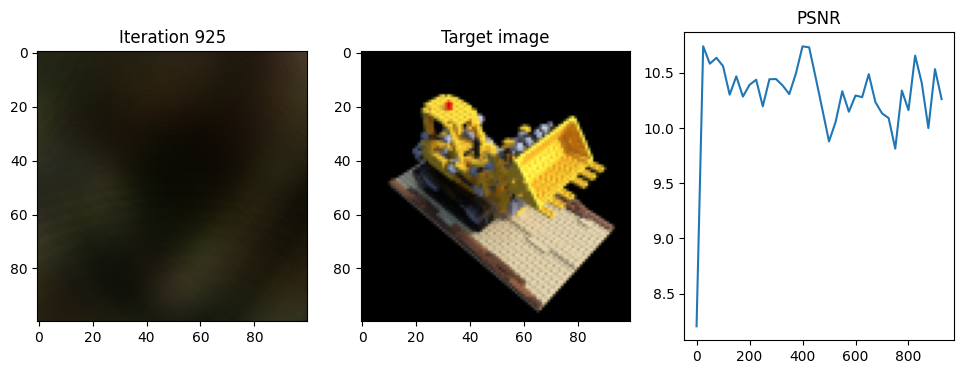

Iteration 950  Loss: 0.1010  PSNR: 9.96  Time: 0.34 secs per iter,  9.72 mins in total
The rotation error as compared to GT Rotation : 1.075059781074524


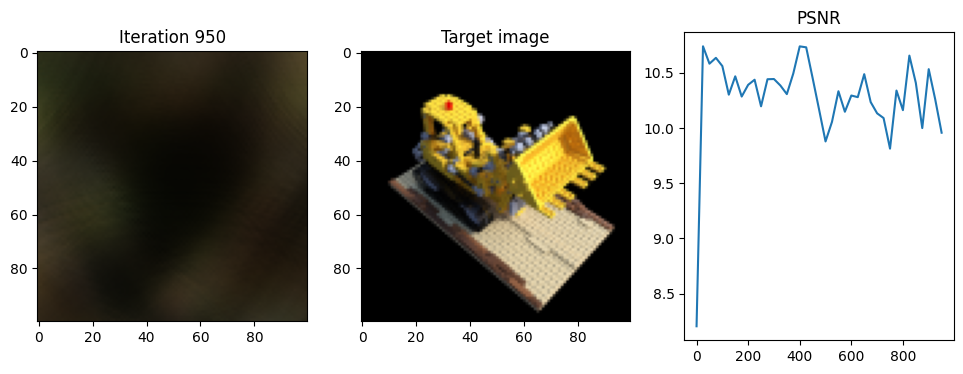

Iteration 975  Loss: 0.1019  PSNR: 9.92  Time: 0.33 secs per iter,  9.85 mins in total
The rotation error as compared to GT Rotation : 1.0750607347488403


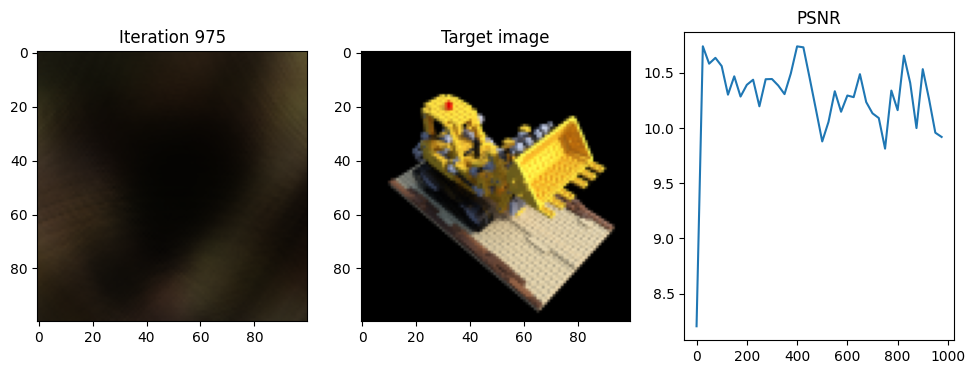

Iteration 1000  Loss: 0.1075  PSNR: 9.69  Time: 0.33 secs per iter,  9.99 mins in total
The rotation error as compared to GT Rotation : 1.0750604486465454


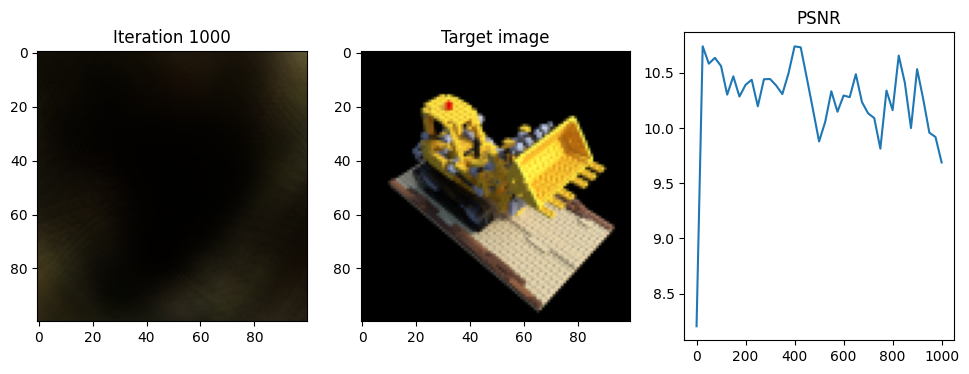

Iteration 1025  Loss: 0.0865  PSNR: 10.63  Time: 0.33 secs per iter,  10.13 mins in total
The rotation error as compared to GT Rotation : 1.075059175491333


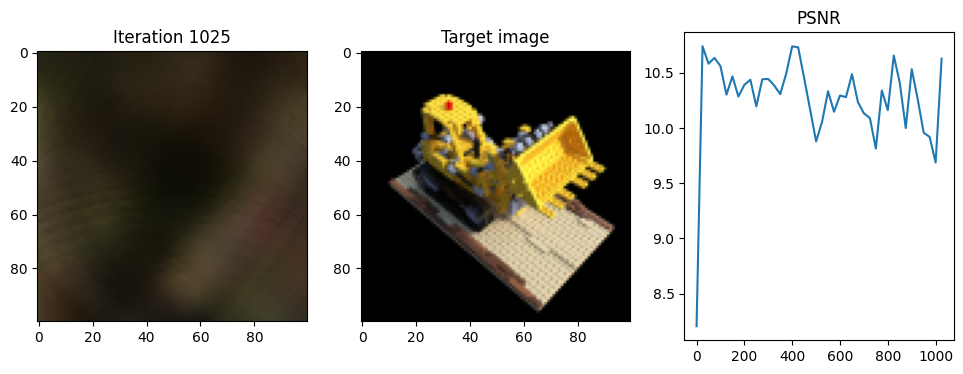

Iteration 1050  Loss: 0.0981  PSNR: 10.08  Time: 0.33 secs per iter,  10.27 mins in total
The rotation error as compared to GT Rotation : 1.0750586223602294


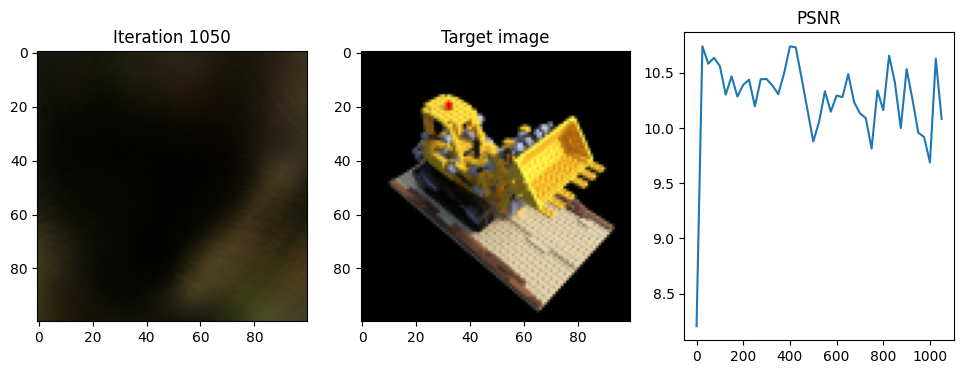

Iteration 1075  Loss: 0.0863  PSNR: 10.64  Time: 0.33 secs per iter,  10.41 mins in total
The rotation error as compared to GT Rotation : 1.0750572729110717


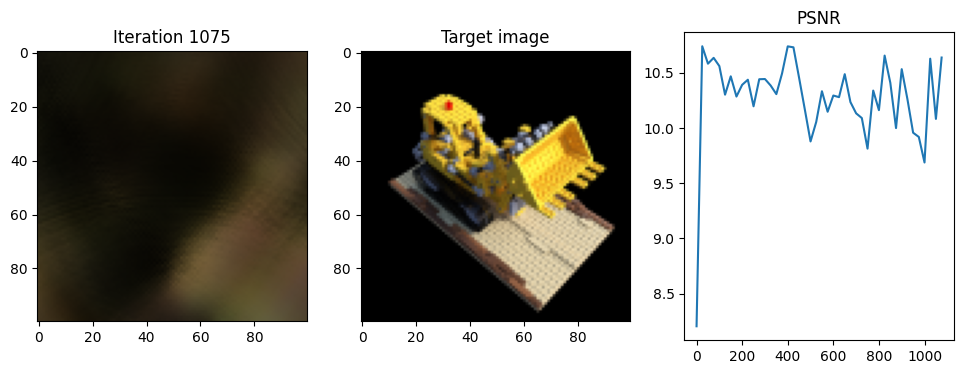

Iteration 1100  Loss: 0.0961  PSNR: 10.17  Time: 0.33 secs per iter,  10.55 mins in total
The rotation error as compared to GT Rotation : 1.07506028175354


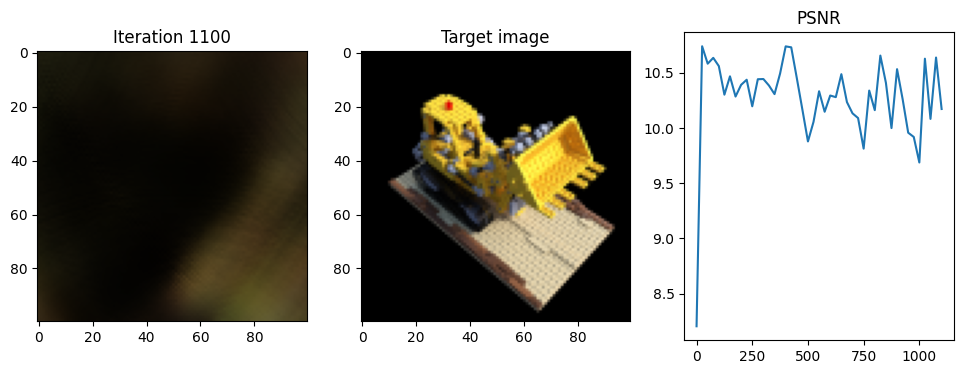

Iteration 1125  Loss: 0.1026  PSNR: 9.89  Time: 0.33 secs per iter,  10.69 mins in total
The rotation error as compared to GT Rotation : 1.0750598573684693


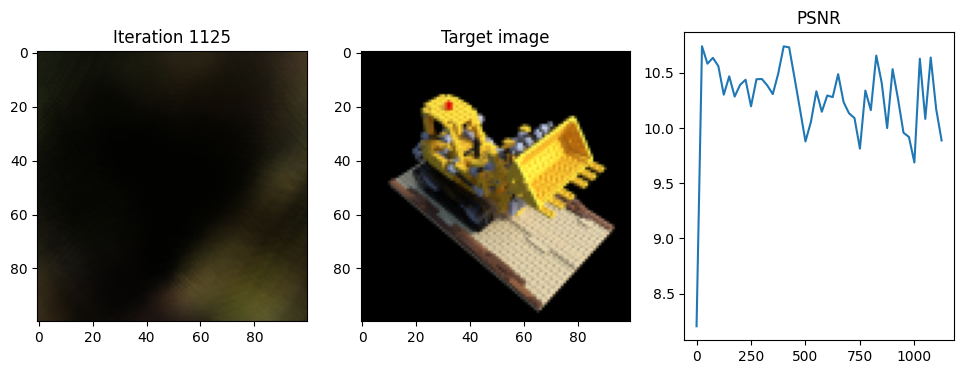

Iteration 1150  Loss: 0.1027  PSNR: 9.89  Time: 0.34 secs per iter,  10.83 mins in total
The rotation error as compared to GT Rotation : 1.075059814453125


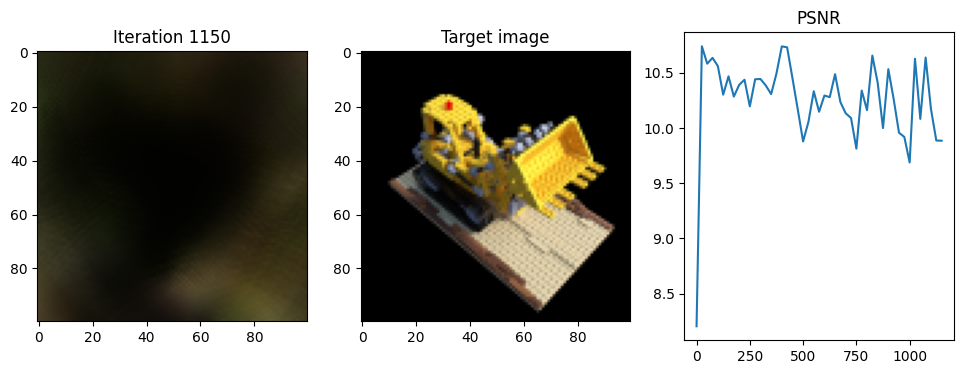

Iteration 1175  Loss: 0.1008  PSNR: 9.97  Time: 0.33 secs per iter,  10.97 mins in total
The rotation error as compared to GT Rotation : 1.075059690475464


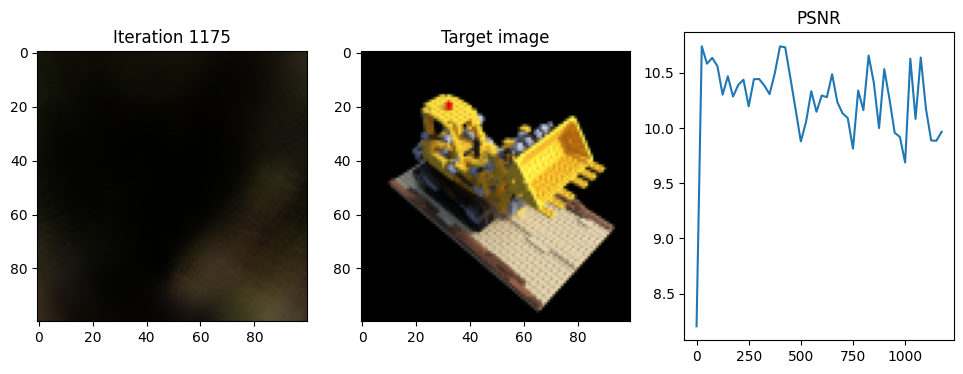

Iteration 1200  Loss: 0.0886  PSNR: 10.53  Time: 0.33 secs per iter,  11.10 mins in total
The rotation error as compared to GT Rotation : 1.0750610733032226


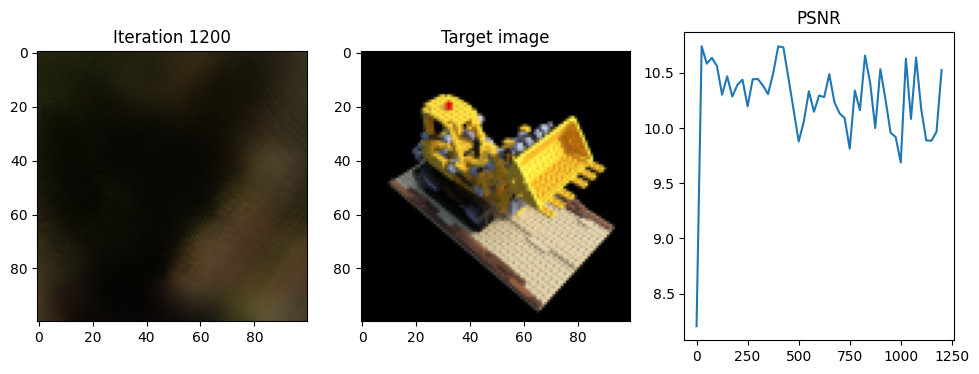

Iteration 1225  Loss: 0.0909  PSNR: 10.41  Time: 0.33 secs per iter,  11.24 mins in total
The rotation error as compared to GT Rotation : 1.0750652980804443


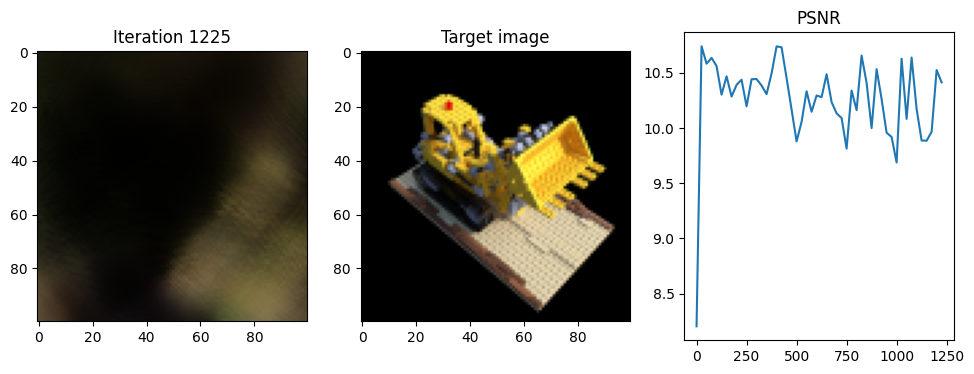

Iteration 1250  Loss: 0.0934  PSNR: 10.30  Time: 0.33 secs per iter,  11.38 mins in total
The rotation error as compared to GT Rotation : 1.0750689268112184


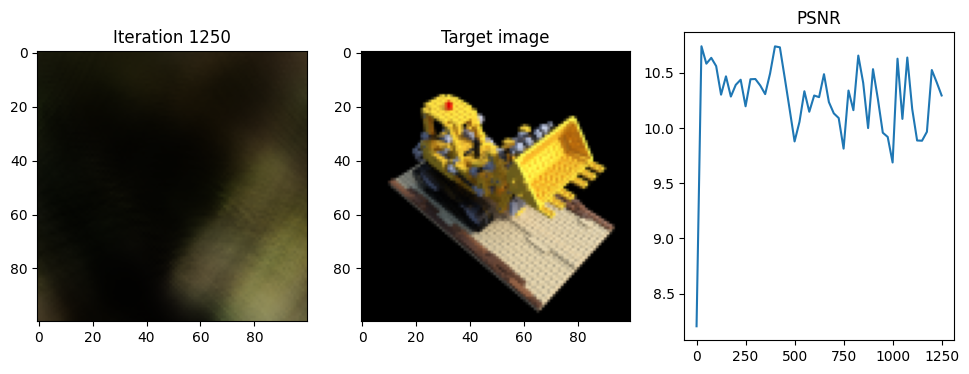

Iteration 1275  Loss: 0.1077  PSNR: 9.68  Time: 0.33 secs per iter,  11.52 mins in total
The rotation error as compared to GT Rotation : 1.0750678586959839


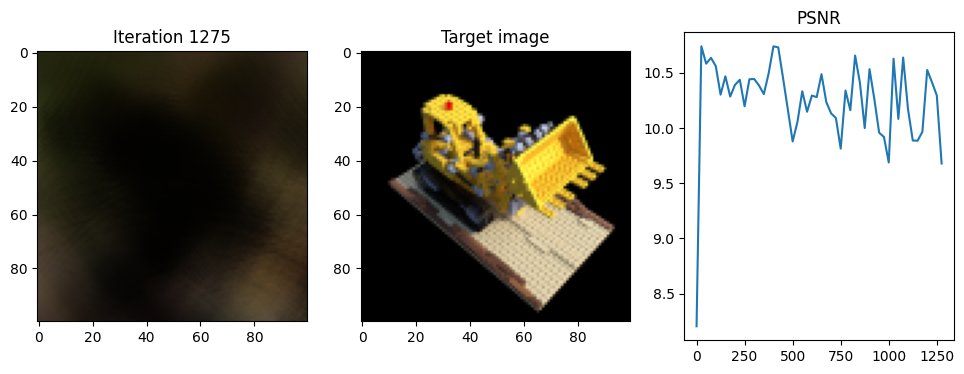

Iteration 1300  Loss: 0.1026  PSNR: 9.89  Time: 0.33 secs per iter,  11.66 mins in total
The rotation error as compared to GT Rotation : 1.0750701141357422


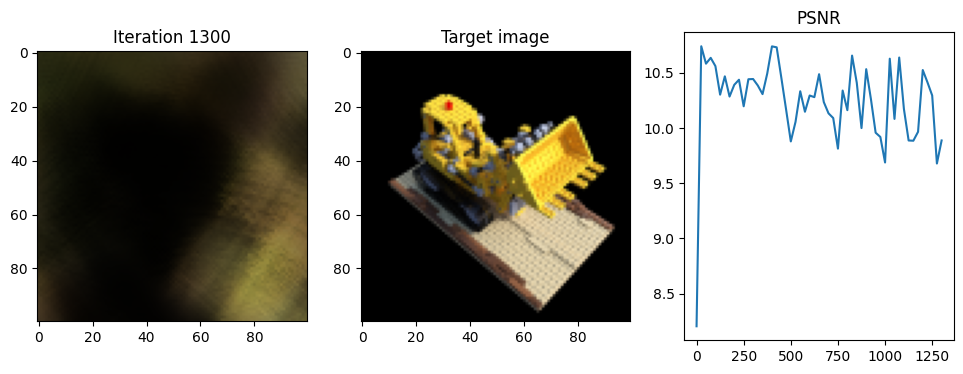

Iteration 1325  Loss: 0.0990  PSNR: 10.04  Time: 0.34 secs per iter,  11.80 mins in total
The rotation error as compared to GT Rotation : 1.0750727319717408


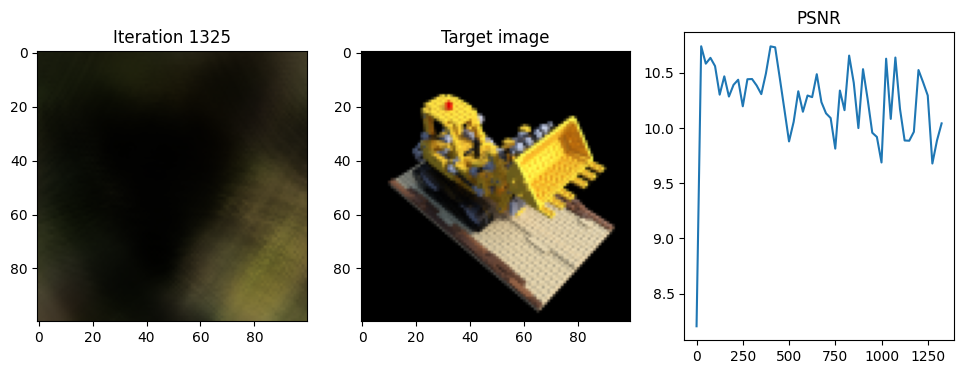

Iteration 1350  Loss: 0.1008  PSNR: 9.97  Time: 0.33 secs per iter,  11.94 mins in total
The rotation error as compared to GT Rotation : 1.0750766706466675


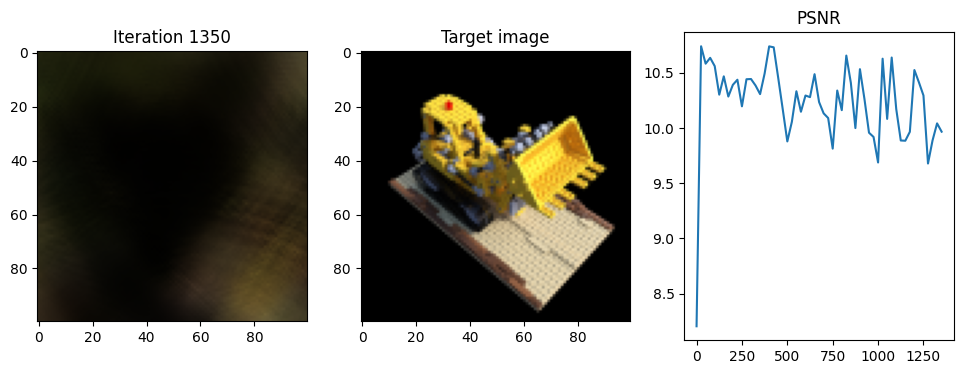

Iteration 1375  Loss: 0.1080  PSNR: 9.67  Time: 0.33 secs per iter,  12.08 mins in total
The rotation error as compared to GT Rotation : 1.0750761318206787


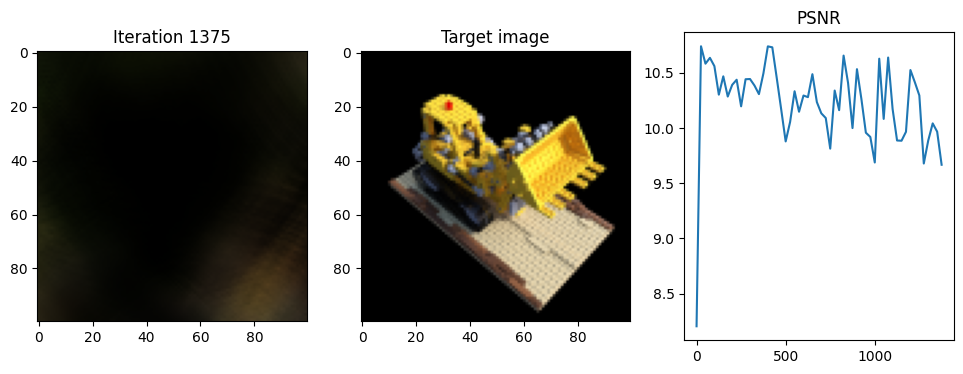

Iteration 1400  Loss: 0.0904  PSNR: 10.44  Time: 0.33 secs per iter,  12.22 mins in total
The rotation error as compared to GT Rotation : 1.0750776195526124


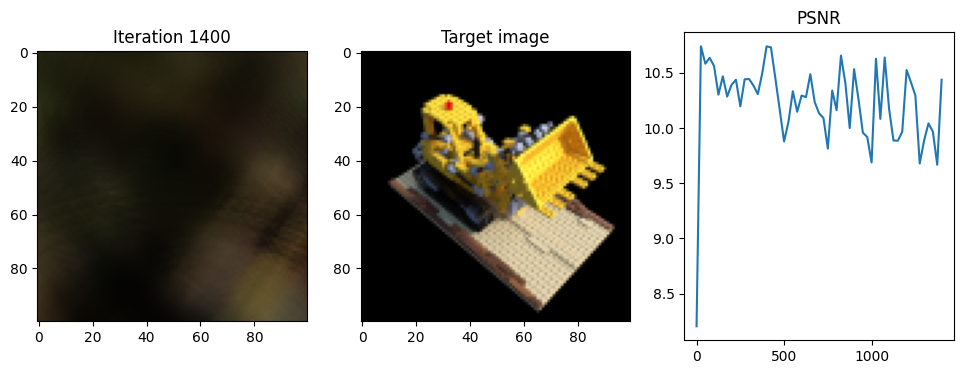

Iteration 1425  Loss: 0.1018  PSNR: 9.92  Time: 0.33 secs per iter,  12.35 mins in total
The rotation error as compared to GT Rotation : 1.07508150100708


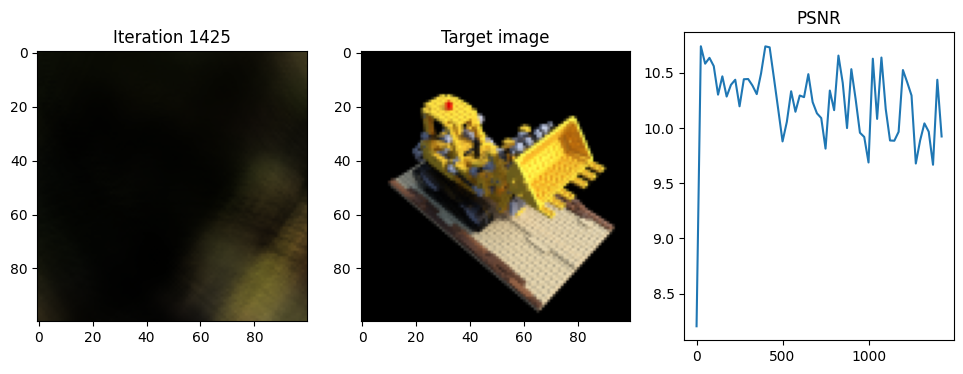

Iteration 1450  Loss: 0.0918  PSNR: 10.37  Time: 0.33 secs per iter,  12.49 mins in total
The rotation error as compared to GT Rotation : 1.0750840044021606


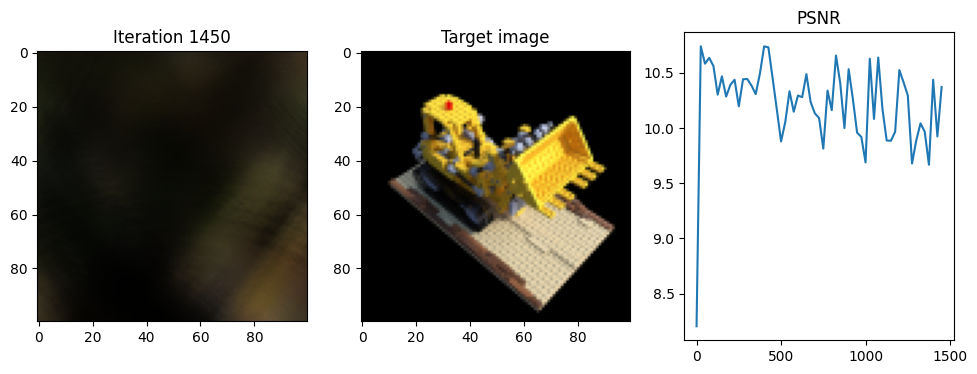

Iteration 1475  Loss: 0.1013  PSNR: 9.94  Time: 0.33 secs per iter,  12.63 mins in total
The rotation error as compared to GT Rotation : 1.0750879621505738


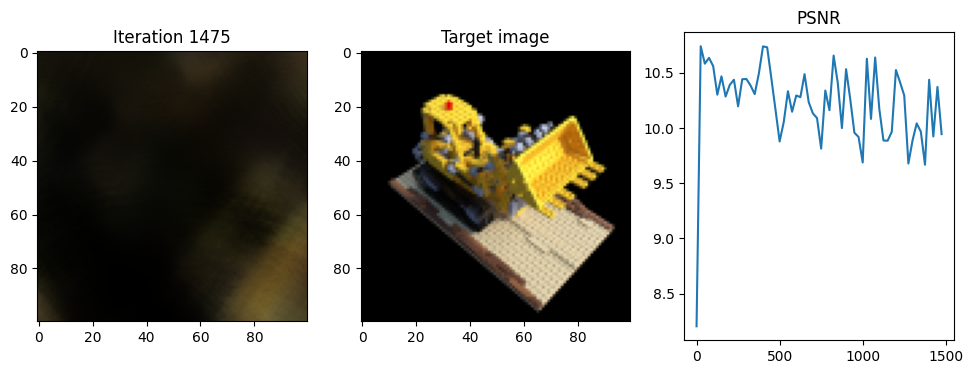

Iteration 1500  Loss: 0.1015  PSNR: 9.94  Time: 0.33 secs per iter,  12.77 mins in total
The rotation error as compared to GT Rotation : 1.0750907230377198


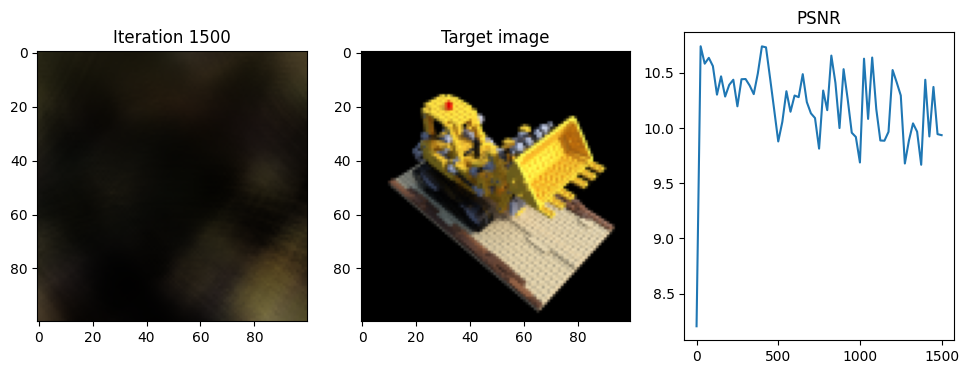

Iteration 1525  Loss: 0.1042  PSNR: 9.82  Time: 0.34 secs per iter,  12.91 mins in total
The rotation error as compared to GT Rotation : 1.0750956058502197


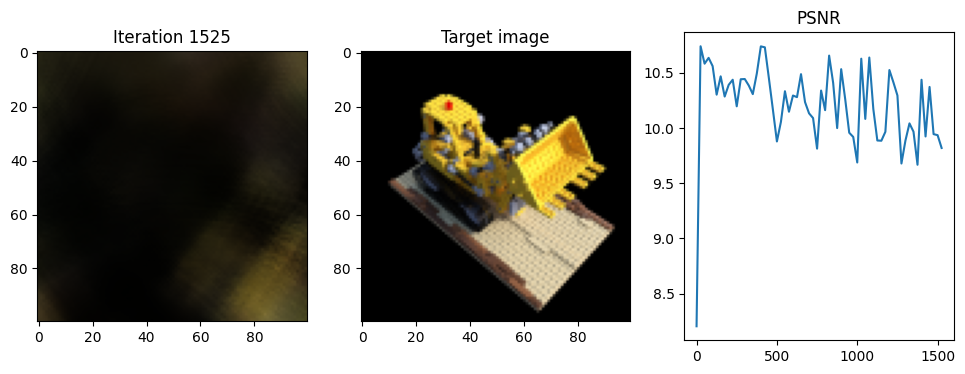

Iteration 1550  Loss: 0.1040  PSNR: 9.83  Time: 0.33 secs per iter,  13.05 mins in total
The rotation error as compared to GT Rotation : 1.0750965356826783


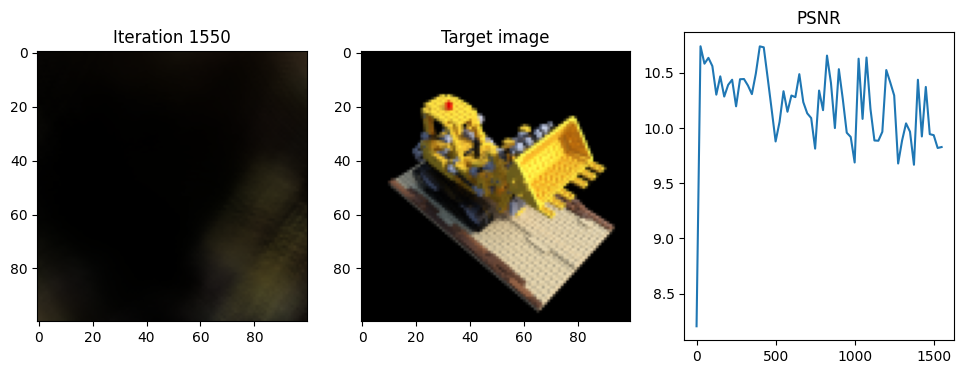

Iteration 1575  Loss: 0.0978  PSNR: 10.10  Time: 0.33 secs per iter,  13.19 mins in total
The rotation error as compared to GT Rotation : 1.0750951433181763


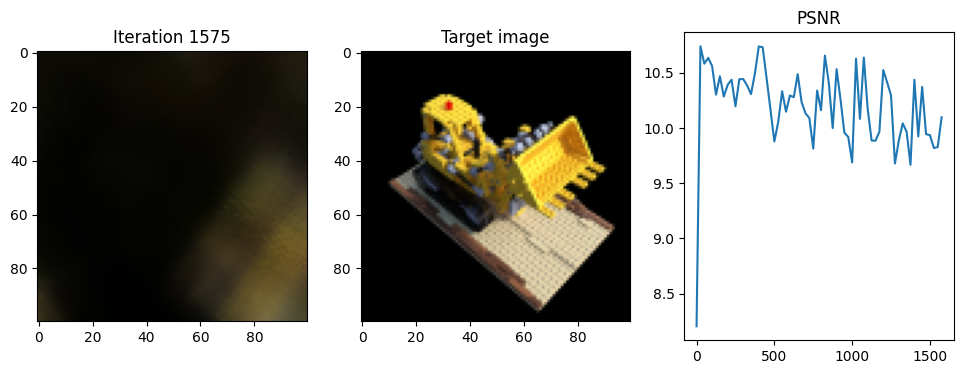

Iteration 1600  Loss: 0.1016  PSNR: 9.93  Time: 0.33 secs per iter,  13.33 mins in total
The rotation error as compared to GT Rotation : 1.0750965690612793


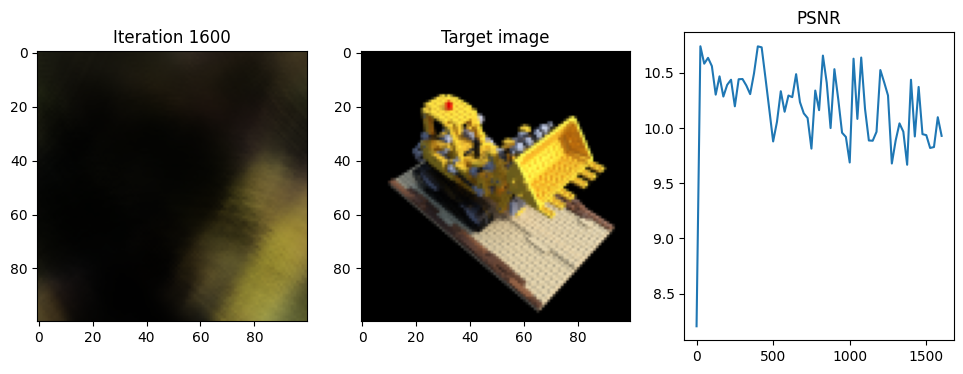

Iteration 1625  Loss: 0.0938  PSNR: 10.28  Time: 0.33 secs per iter,  13.46 mins in total
The rotation error as compared to GT Rotation : 1.0751000499725343


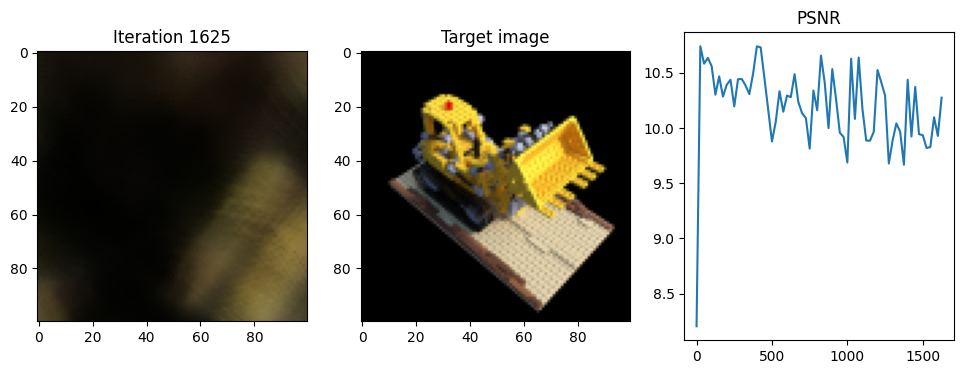

Iteration 1650  Loss: 0.0988  PSNR: 10.05  Time: 0.33 secs per iter,  13.60 mins in total
The rotation error as compared to GT Rotation : 1.075104603767395


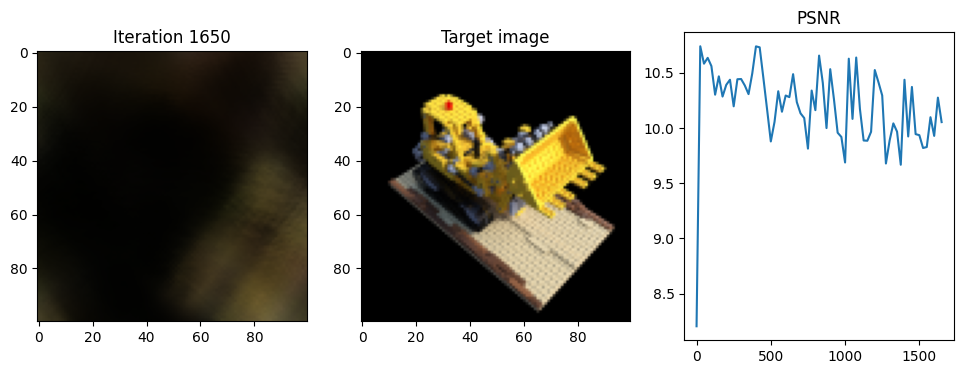

Iteration 1675  Loss: 0.1093  PSNR: 9.61  Time: 0.33 secs per iter,  13.74 mins in total
The rotation error as compared to GT Rotation : 1.0751014375686645


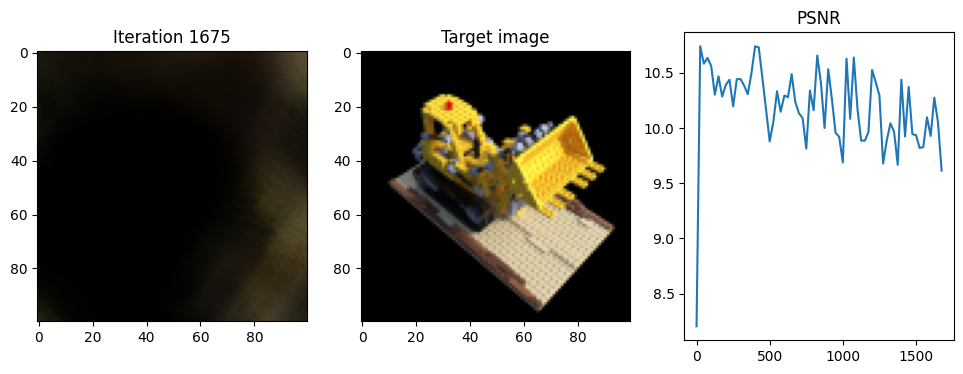

Iteration 1700  Loss: 0.1056  PSNR: 9.76  Time: 0.33 secs per iter,  13.88 mins in total
The rotation error as compared to GT Rotation : 1.075103931427002


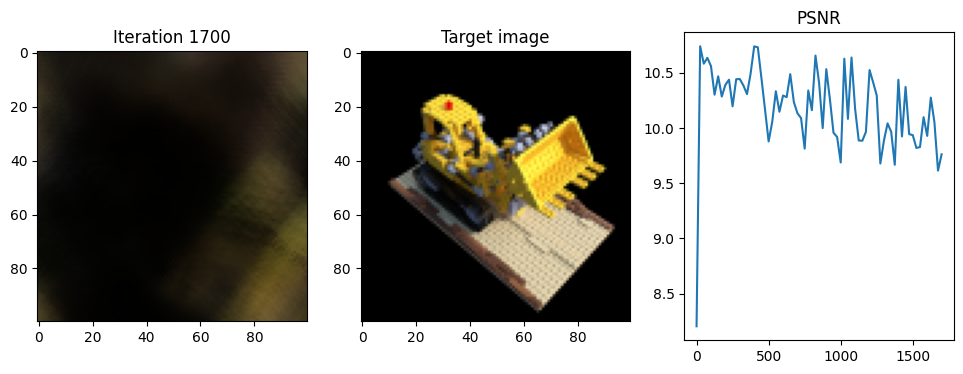

Iteration 1725  Loss: 0.1048  PSNR: 9.80  Time: 0.34 secs per iter,  14.02 mins in total
The rotation error as compared to GT Rotation : 1.0751054191589355


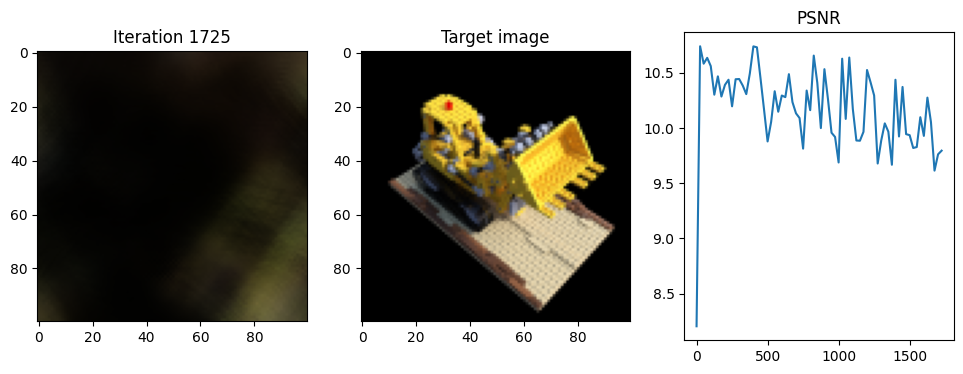

Iteration 1750  Loss: 0.0988  PSNR: 10.05  Time: 0.33 secs per iter,  14.16 mins in total
The rotation error as compared to GT Rotation : 1.0751099395751953


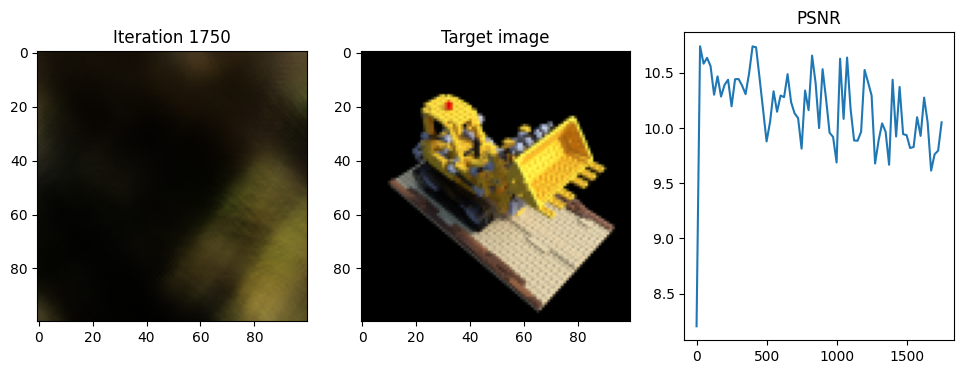

Iteration 1775  Loss: 0.1109  PSNR: 9.55  Time: 0.33 secs per iter,  14.30 mins in total
The rotation error as compared to GT Rotation : 1.0751140546798705


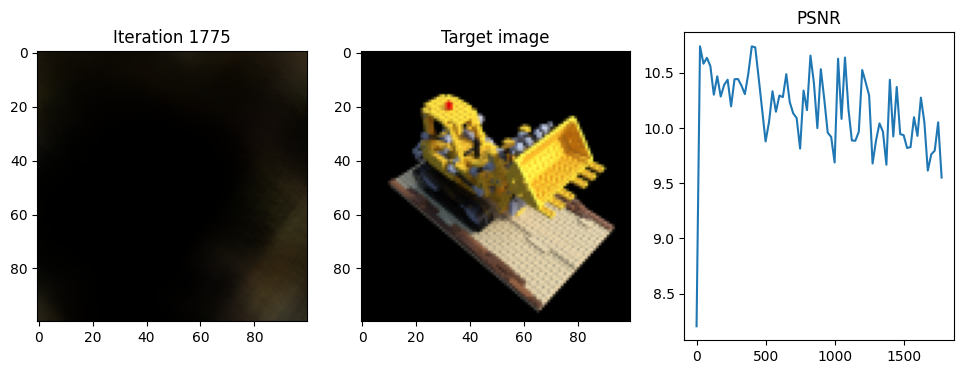

Iteration 1800  Loss: 0.1088  PSNR: 9.63  Time: 0.33 secs per iter,  14.44 mins in total
The rotation error as compared to GT Rotation : 1.0751136255264282


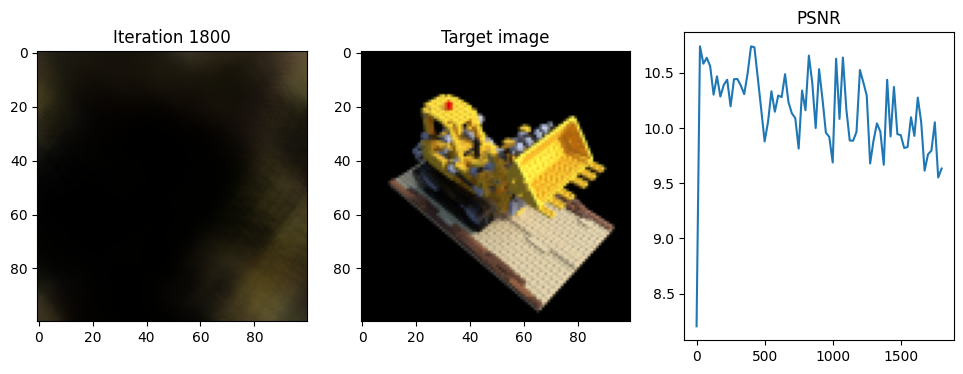

Iteration 1825  Loss: 0.1014  PSNR: 9.94  Time: 0.33 secs per iter,  14.57 mins in total
The rotation error as compared to GT Rotation : 1.0751173162460328


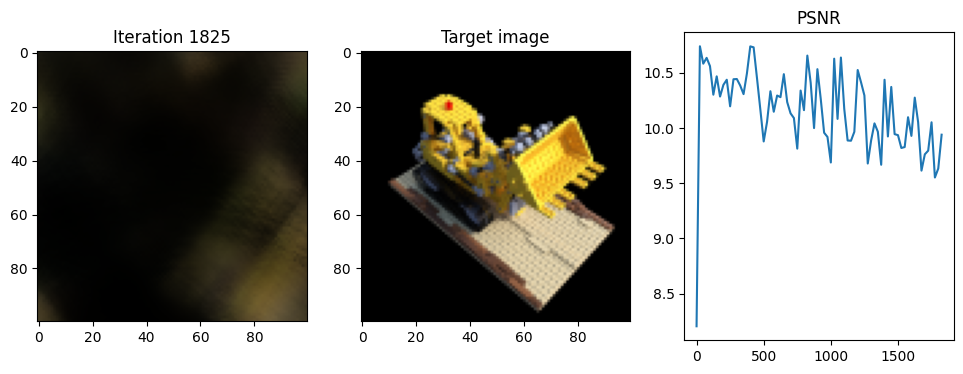

Iteration 1850  Loss: 0.1082  PSNR: 9.66  Time: 0.33 secs per iter,  14.71 mins in total
The rotation error as compared to GT Rotation : 1.075119366645813


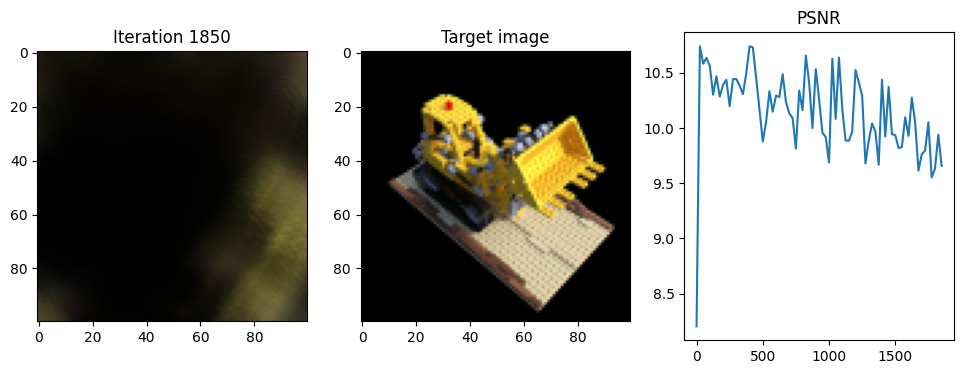

Iteration 1875  Loss: 0.0955  PSNR: 10.20  Time: 0.33 secs per iter,  14.85 mins in total
The rotation error as compared to GT Rotation : 1.0751246547698974


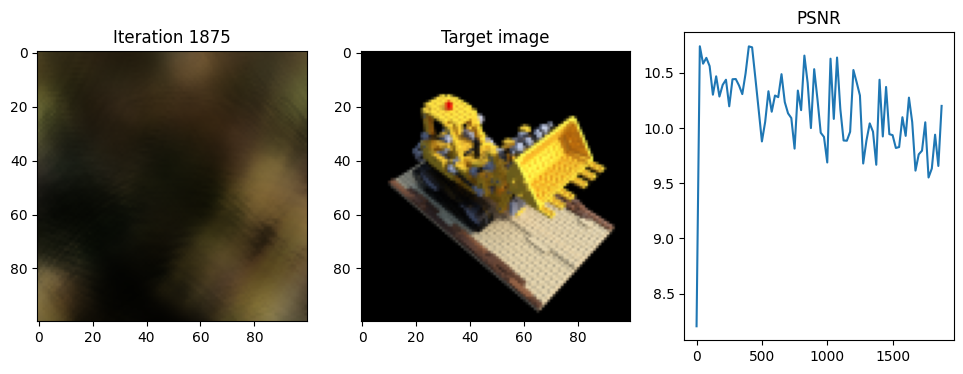

Iteration 1900  Loss: 0.1016  PSNR: 9.93  Time: 0.33 secs per iter,  14.99 mins in total
The rotation error as compared to GT Rotation : 1.0751289892196656


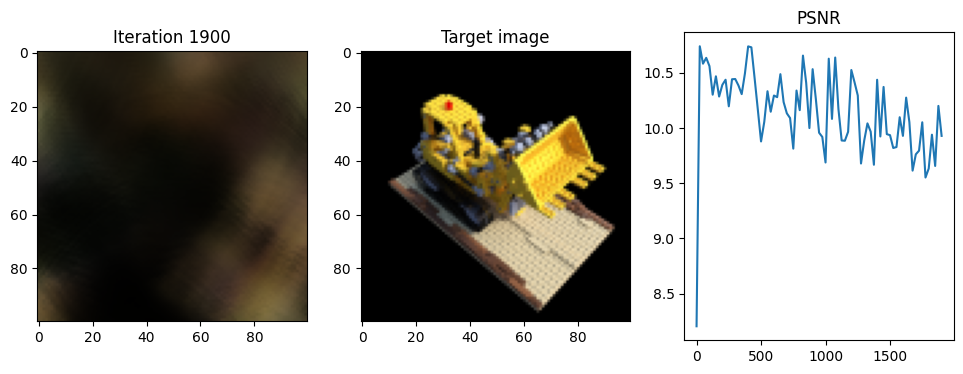

Iteration 1925  Loss: 0.1092  PSNR: 9.62  Time: 0.34 secs per iter,  15.13 mins in total
The rotation error as compared to GT Rotation : 1.07512779712677


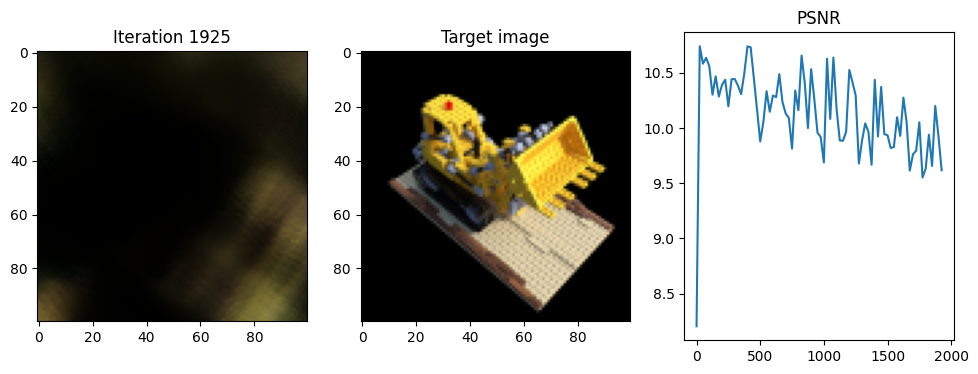

Iteration 1950  Loss: 0.1078  PSNR: 9.67  Time: 0.33 secs per iter,  15.27 mins in total
The rotation error as compared to GT Rotation : 1.0751297903060912


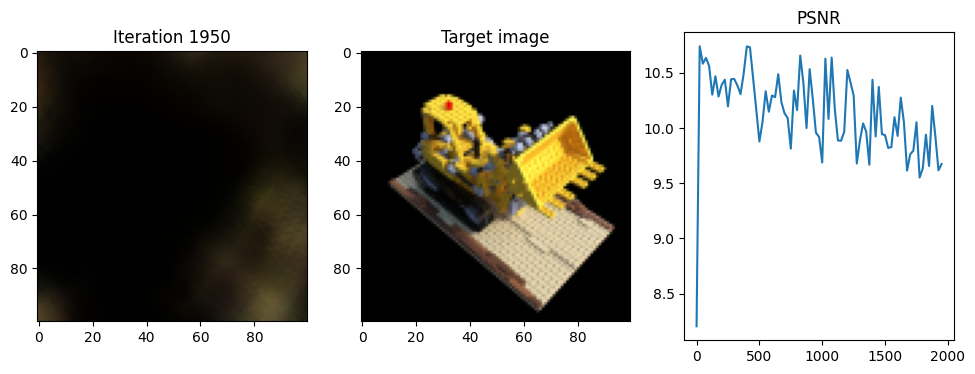

Iteration 1975  Loss: 0.1063  PSNR: 9.74  Time: 0.33 secs per iter,  15.41 mins in total
The rotation error as compared to GT Rotation : 1.0751280975341797


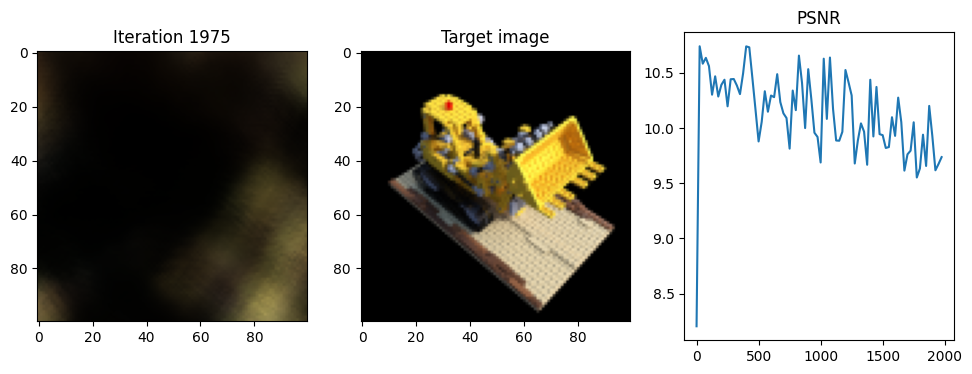

Iteration 2000  Loss: 0.1050  PSNR: 9.79  Time: 0.33 secs per iter,  15.55 mins in total
The rotation error as compared to GT Rotation : 1.0751214742660522


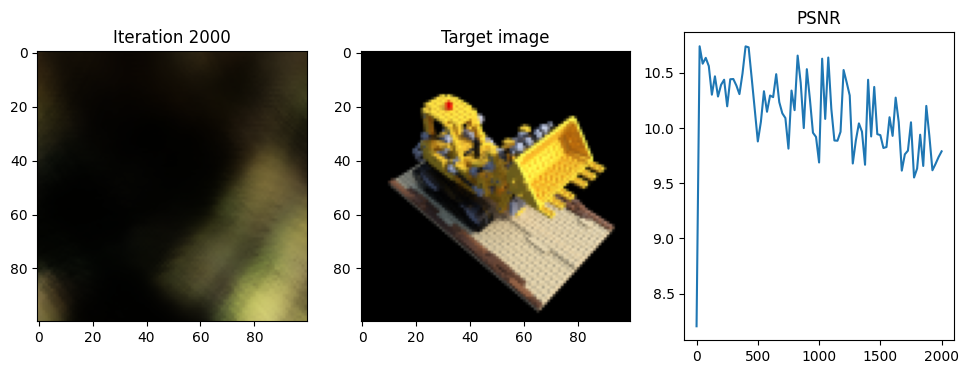

Iteration 2025  Loss: 0.1092  PSNR: 9.62  Time: 0.33 secs per iter,  15.68 mins in total
The rotation error as compared to GT Rotation : 1.0751274824142456


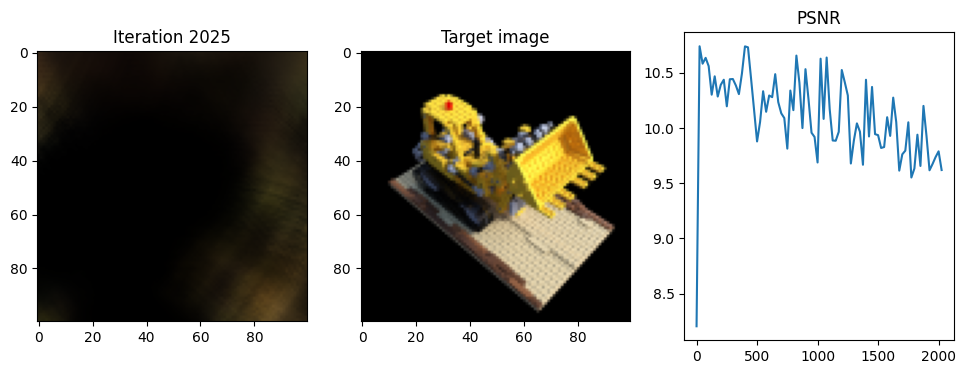

Iteration 2050  Loss: 0.1067  PSNR: 9.72  Time: 0.33 secs per iter,  15.82 mins in total
The rotation error as compared to GT Rotation : 1.075130214691162


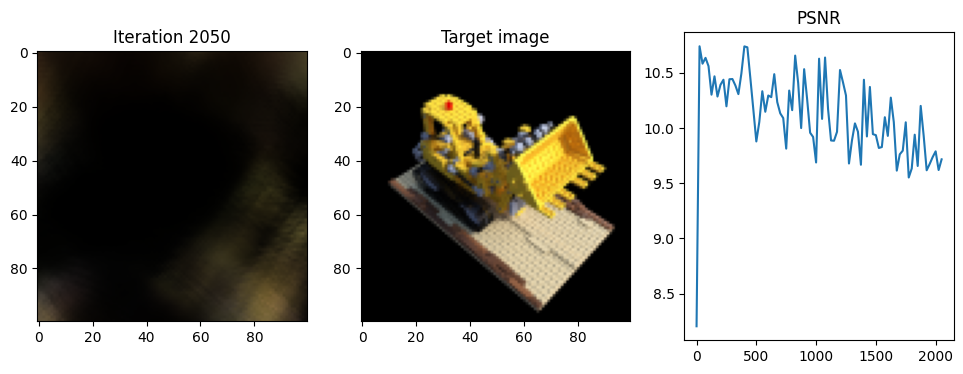

Iteration 2075  Loss: 0.1027  PSNR: 9.88  Time: 0.33 secs per iter,  15.96 mins in total
The rotation error as compared to GT Rotation : 1.0751350450515746


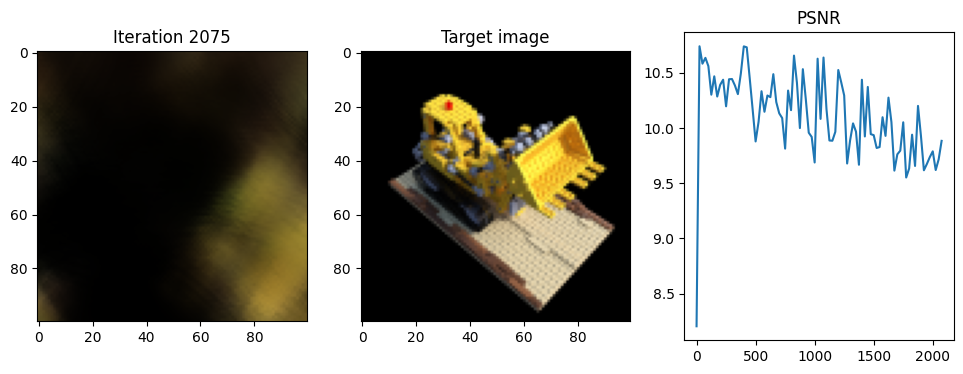

Iteration 2100  Loss: 0.1016  PSNR: 9.93  Time: 0.33 secs per iter,  16.10 mins in total
The rotation error as compared to GT Rotation : 1.0751304006576539


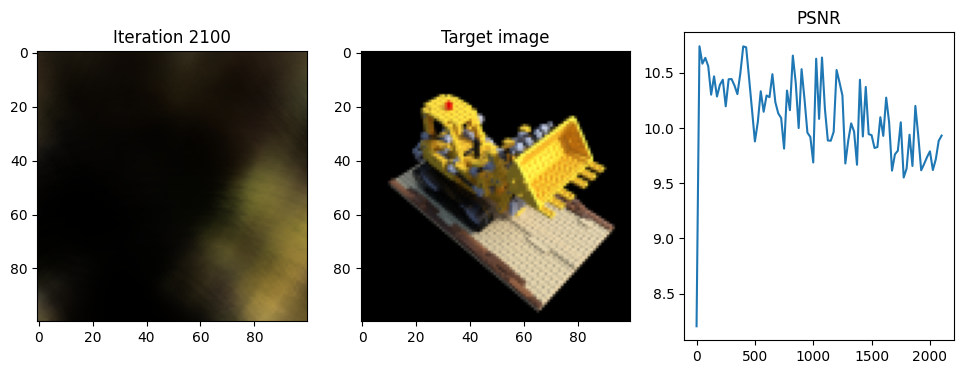

Iteration 2125  Loss: 0.1063  PSNR: 9.74  Time: 0.34 secs per iter,  16.24 mins in total
The rotation error as compared to GT Rotation : 1.0751231622695923


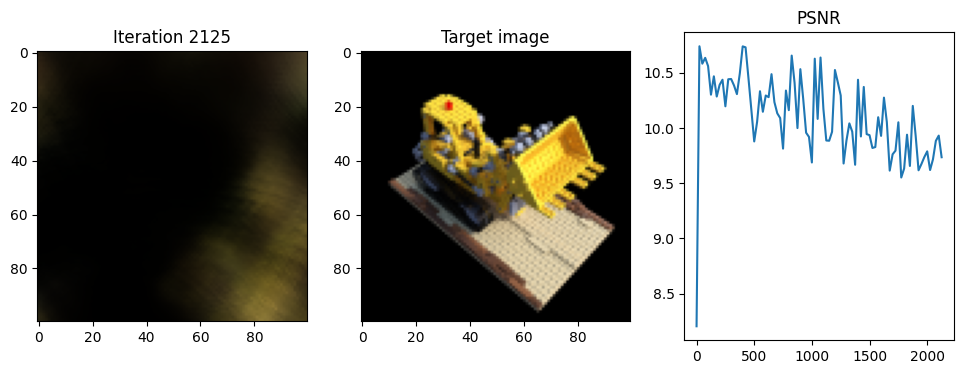

Iteration 2150  Loss: 0.1105  PSNR: 9.57  Time: 0.33 secs per iter,  16.38 mins in total
The rotation error as compared to GT Rotation : 1.0751251459121705


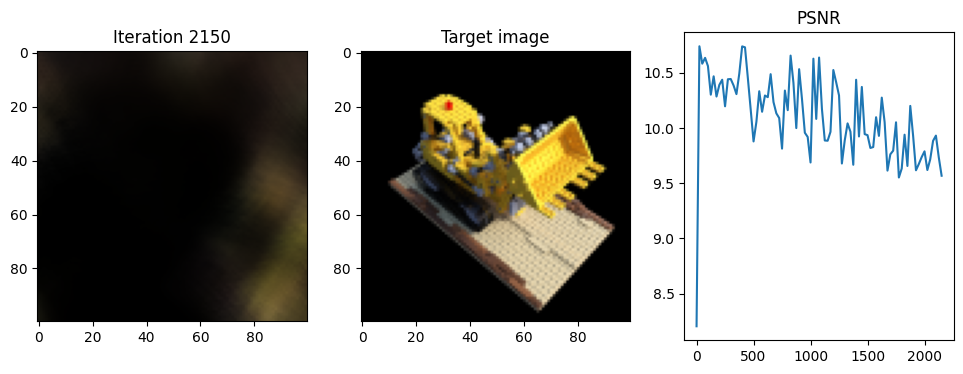

Iteration 2175  Loss: 0.1054  PSNR: 9.77  Time: 0.33 secs per iter,  16.52 mins in total
The rotation error as compared to GT Rotation : 1.0751227617263794


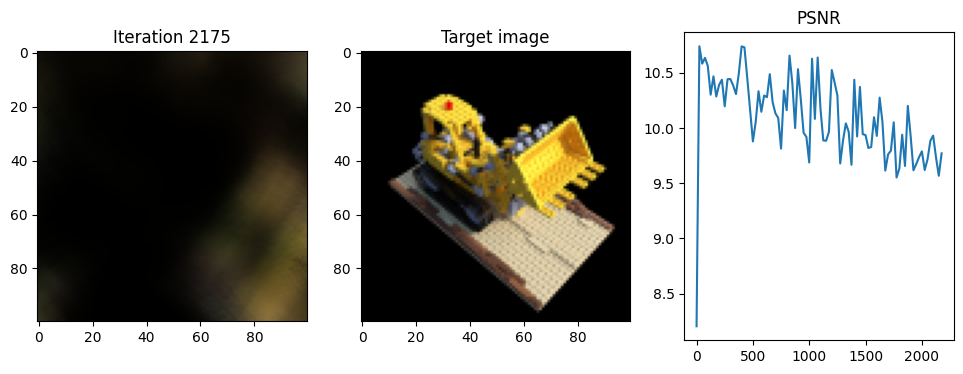

Iteration 2200  Loss: 0.1071  PSNR: 9.70  Time: 0.33 secs per iter,  16.65 mins in total
The rotation error as compared to GT Rotation : 1.0751227998733521


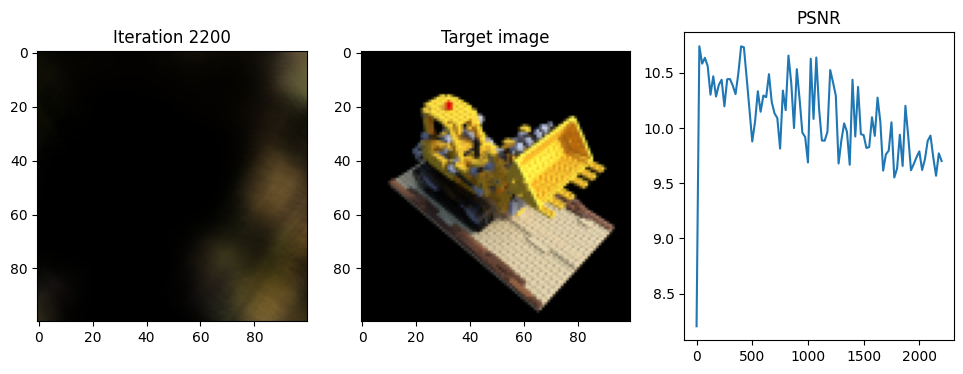

Iteration 2225  Loss: 0.1066  PSNR: 9.72  Time: 0.33 secs per iter,  16.79 mins in total
The rotation error as compared to GT Rotation : 1.0751284646987915


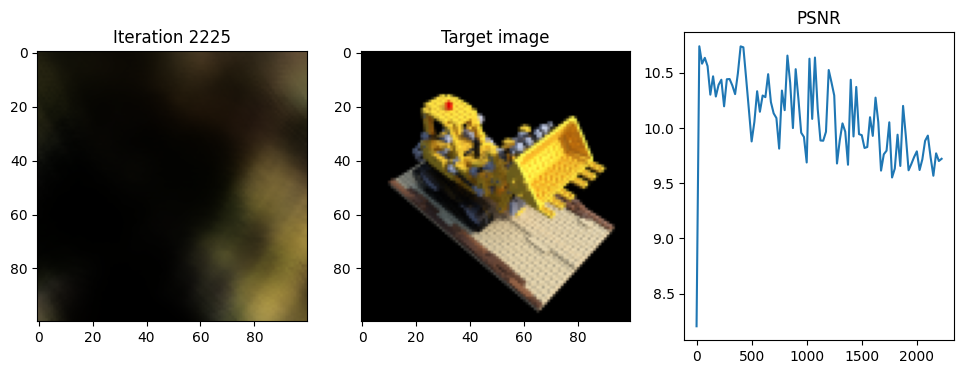

Iteration 2250  Loss: 0.1095  PSNR: 9.61  Time: 0.33 secs per iter,  16.93 mins in total
The rotation error as compared to GT Rotation : 1.0751249647140504


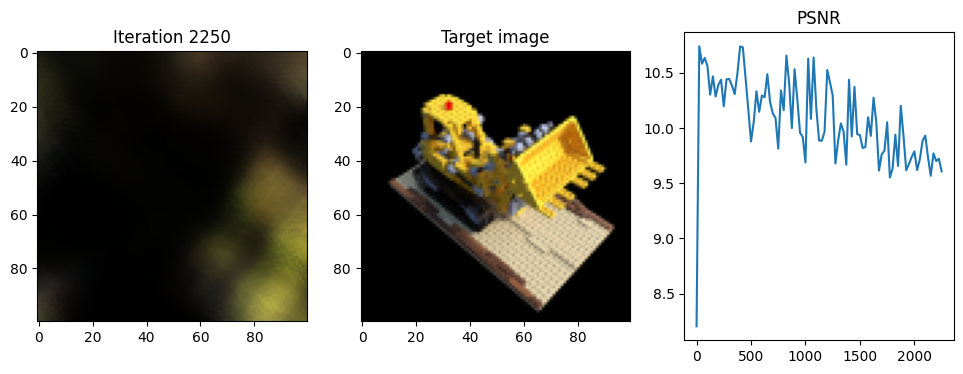

Iteration 2275  Loss: 0.1086  PSNR: 9.64  Time: 0.33 secs per iter,  17.07 mins in total
The rotation error as compared to GT Rotation : 1.0751228952407836


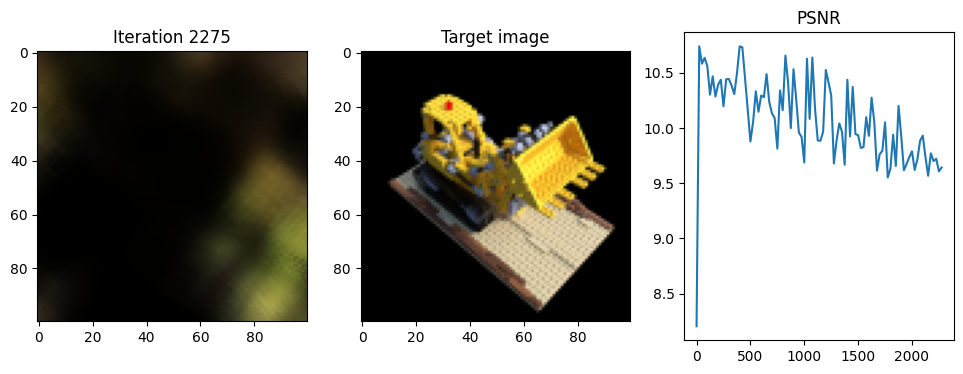

Iteration 2300  Loss: 0.1115  PSNR: 9.53  Time: 0.33 secs per iter,  17.21 mins in total
The rotation error as compared to GT Rotation : 1.0751210498809813


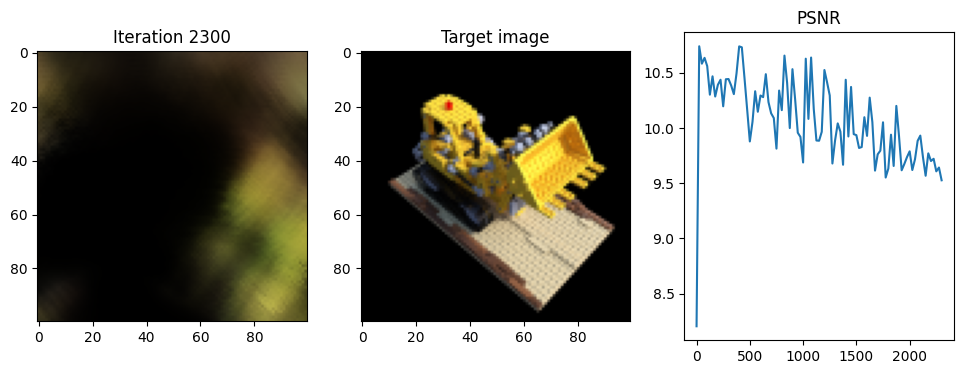

Iteration 2325  Loss: 0.1068  PSNR: 9.72  Time: 0.34 secs per iter,  17.35 mins in total
The rotation error as compared to GT Rotation : 1.0751241779327392


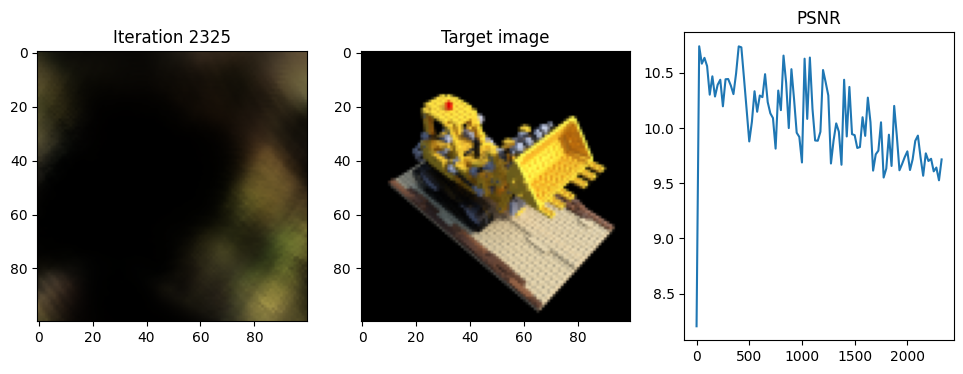

Iteration 2350  Loss: 0.1140  PSNR: 9.43  Time: 0.33 secs per iter,  17.49 mins in total
The rotation error as compared to GT Rotation : 1.075128231048584


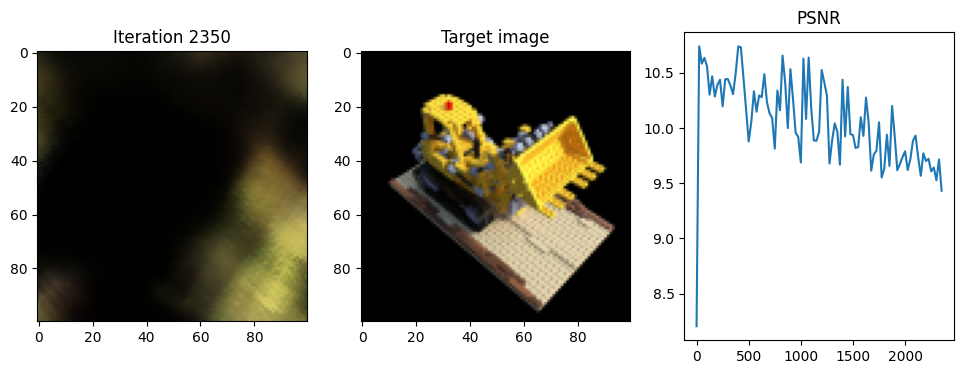

Iteration 2375  Loss: 0.1057  PSNR: 9.76  Time: 0.33 secs per iter,  17.63 mins in total
The rotation error as compared to GT Rotation : 1.0751335334777832


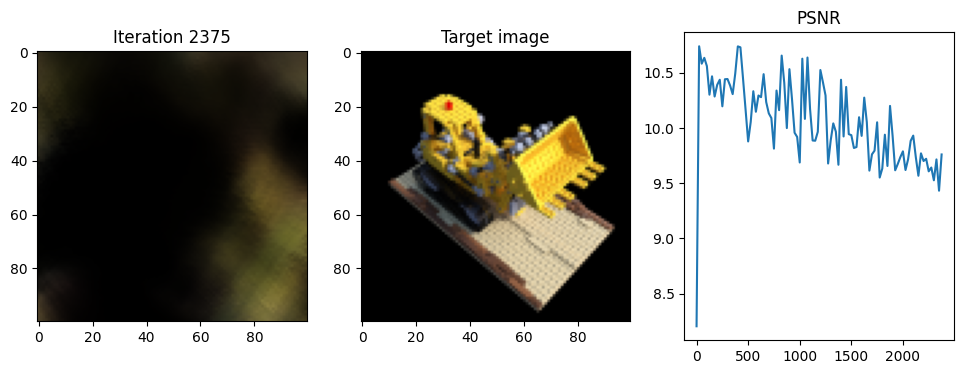

Iteration 2400  Loss: 0.1086  PSNR: 9.64  Time: 0.33 secs per iter,  17.77 mins in total
The rotation error as compared to GT Rotation : 1.0751346778869628


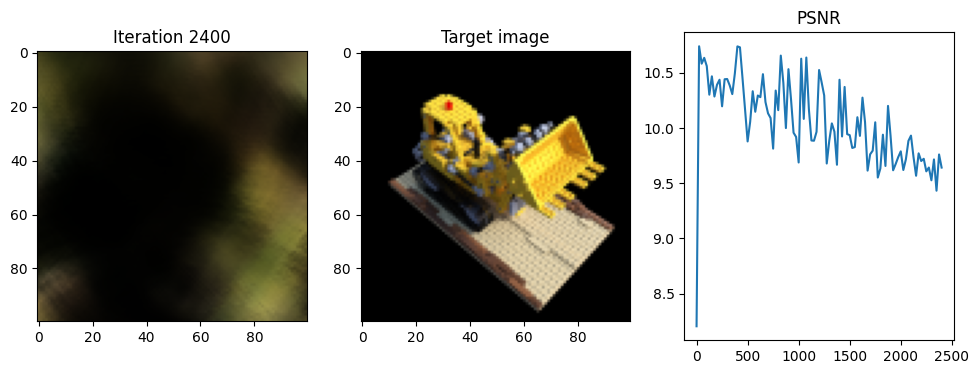

Iteration 2425  Loss: 0.1127  PSNR: 9.48  Time: 0.33 secs per iter,  17.90 mins in total
The rotation error as compared to GT Rotation : 1.075133695602417


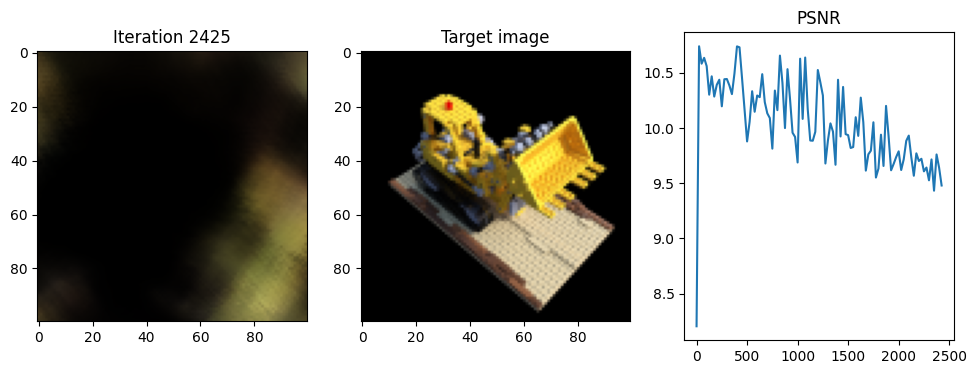

Iteration 2450  Loss: 0.1149  PSNR: 9.40  Time: 0.33 secs per iter,  18.04 mins in total
The rotation error as compared to GT Rotation : 1.0751327228546144


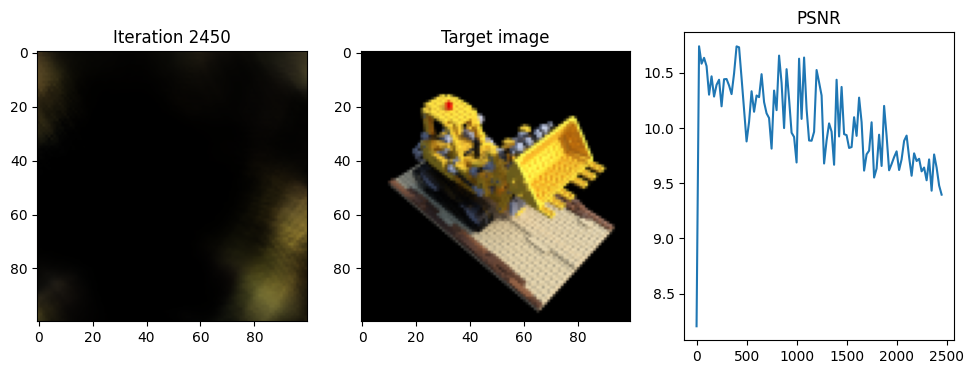

Iteration 2475  Loss: 0.1164  PSNR: 9.34  Time: 0.33 secs per iter,  18.18 mins in total
The rotation error as compared to GT Rotation : 1.0751358127593995


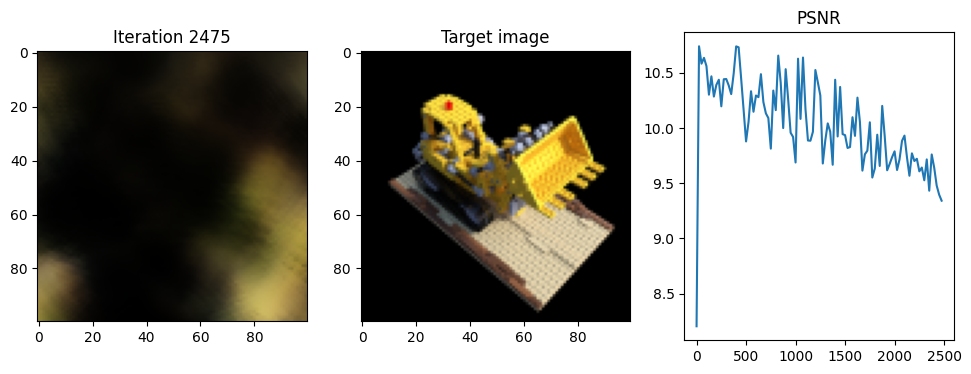

Iteration 2500  Loss: 0.1151  PSNR: 9.39  Time: 0.34 secs per iter,  18.32 mins in total
The rotation error as compared to GT Rotation : 1.075139307975769


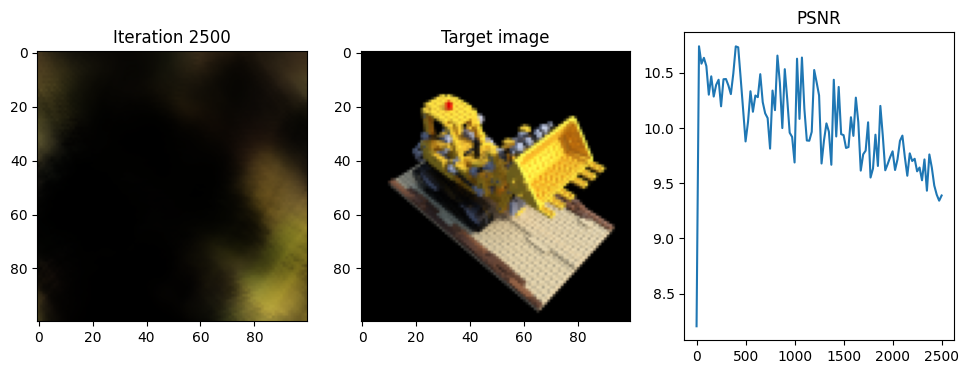

Iteration 2525  Loss: 0.1123  PSNR: 9.50  Time: 0.33 secs per iter,  18.46 mins in total
The rotation error as compared to GT Rotation : 1.0751385164260865


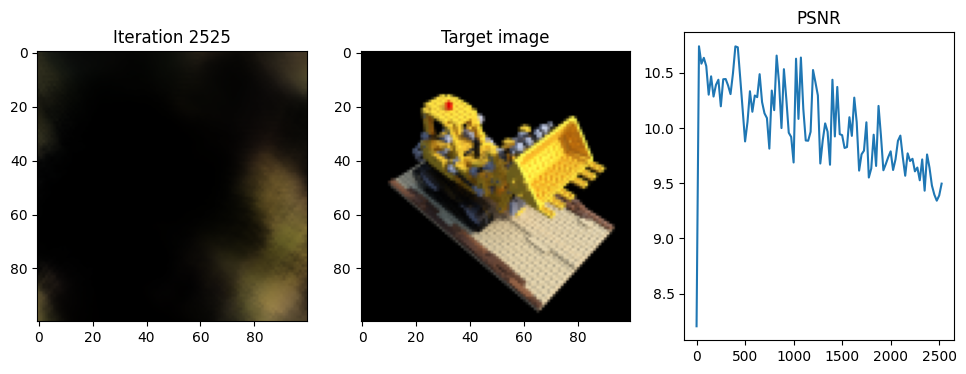

Iteration 2550  Loss: 0.1122  PSNR: 9.50  Time: 0.33 secs per iter,  18.60 mins in total
The rotation error as compared to GT Rotation : 1.075140061378479


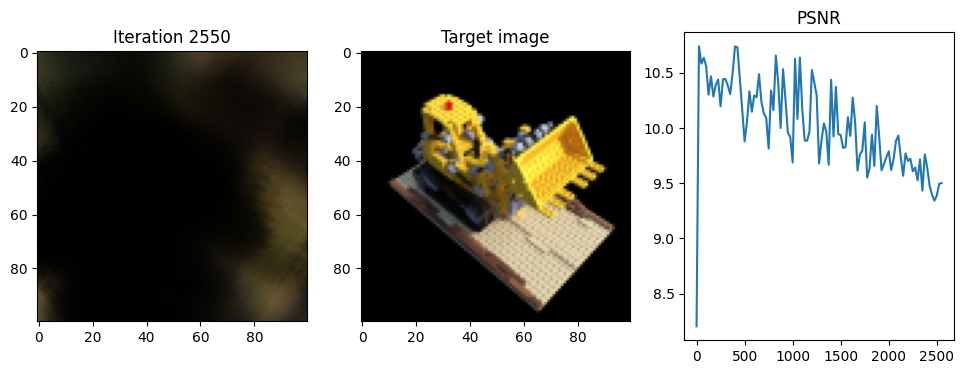

Iteration 2575  Loss: 0.1171  PSNR: 9.31  Time: 0.33 secs per iter,  18.74 mins in total
The rotation error as compared to GT Rotation : 1.0751452255249023


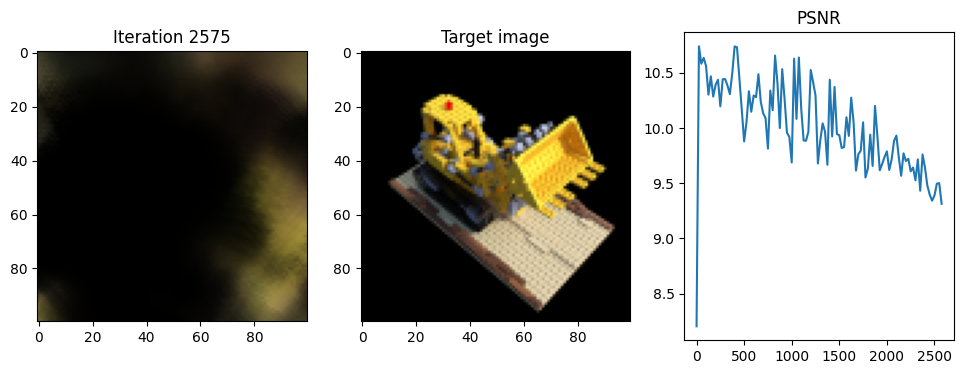

Iteration 2600  Loss: 0.1192  PSNR: 9.24  Time: 0.33 secs per iter,  18.88 mins in total
The rotation error as compared to GT Rotation : 1.0751466512680055


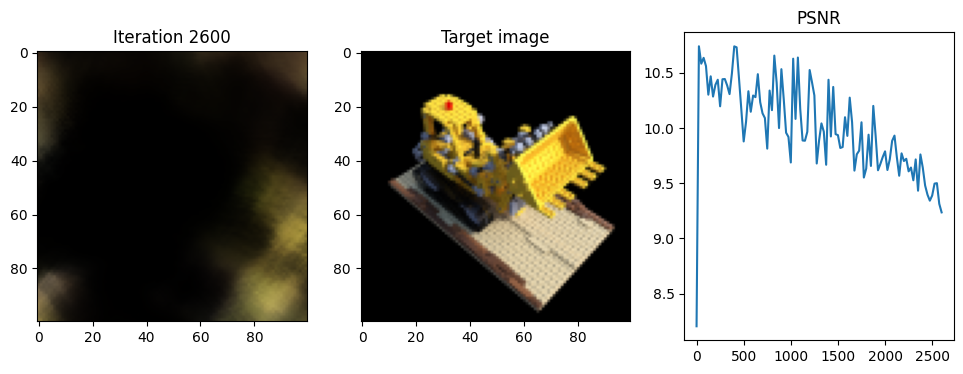

Iteration 2625  Loss: 0.1121  PSNR: 9.50  Time: 0.33 secs per iter,  19.01 mins in total
The rotation error as compared to GT Rotation : 1.0751500272750854


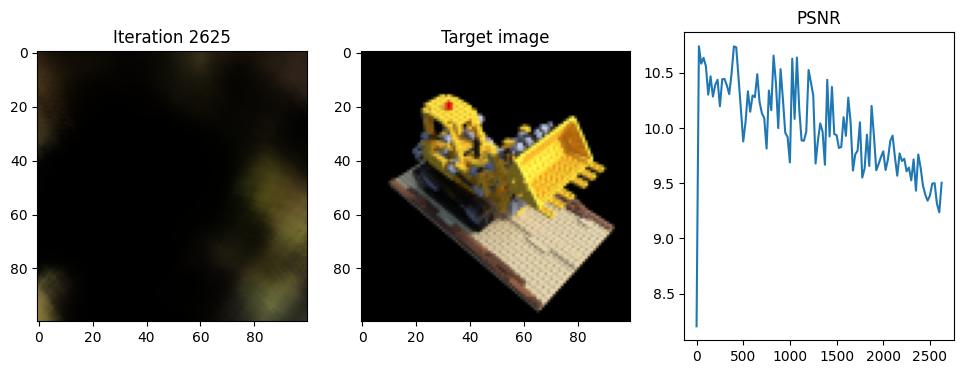

Iteration 2650  Loss: 0.1155  PSNR: 9.38  Time: 0.33 secs per iter,  19.15 mins in total
The rotation error as compared to GT Rotation : 1.0751476621627807


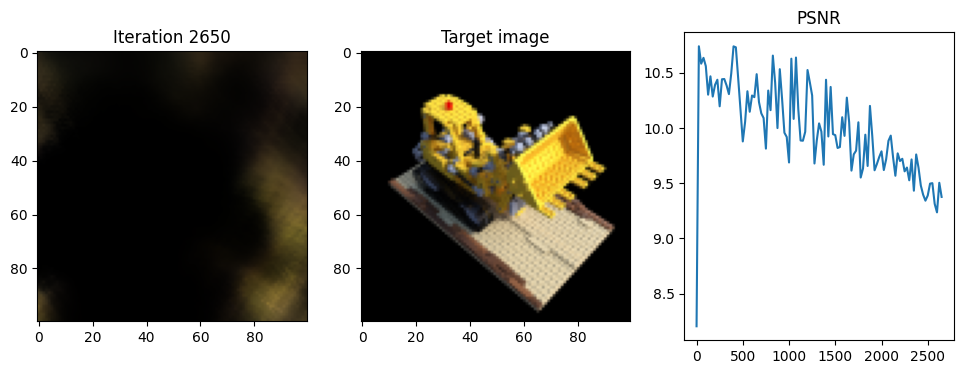

Iteration 2675  Loss: 0.1164  PSNR: 9.34  Time: 0.33 secs per iter,  19.29 mins in total
The rotation error as compared to GT Rotation : 1.0751471662521361


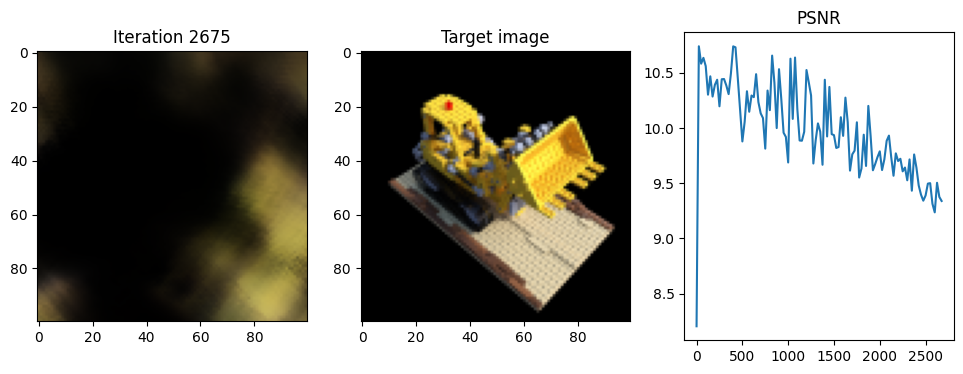

Iteration 2700  Loss: 0.1120  PSNR: 9.51  Time: 0.34 secs per iter,  19.43 mins in total
The rotation error as compared to GT Rotation : 1.0751457262039184


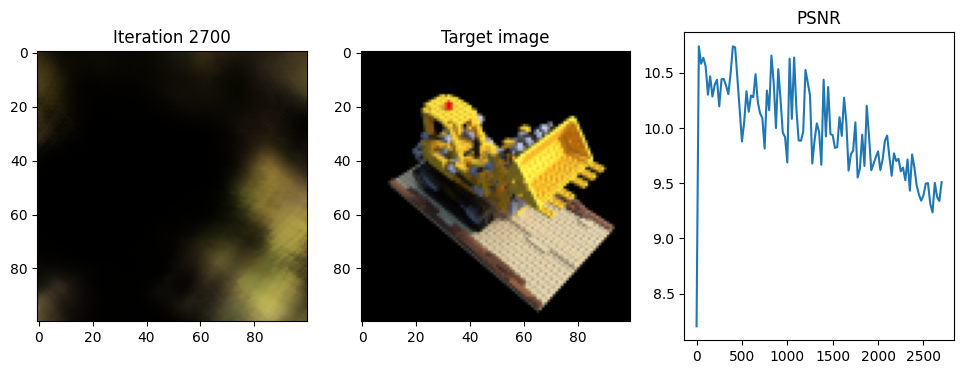

Iteration 2725  Loss: 0.1138  PSNR: 9.44  Time: 0.33 secs per iter,  19.57 mins in total
The rotation error as compared to GT Rotation : 1.0751515293121339


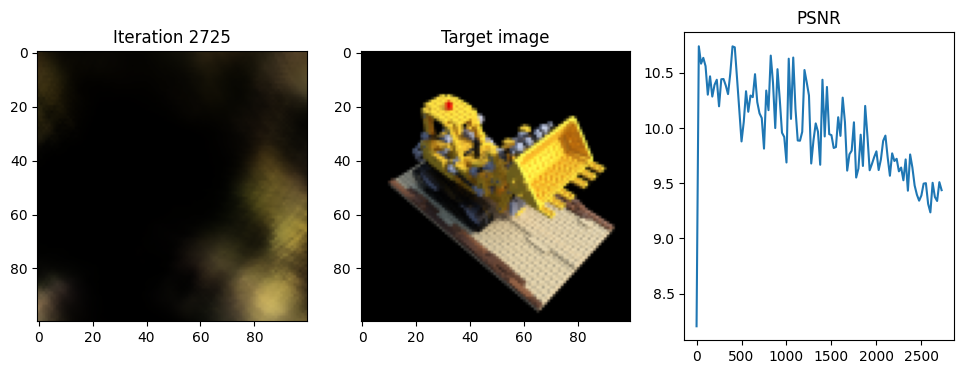

Iteration 2750  Loss: 0.1149  PSNR: 9.40  Time: 0.33 secs per iter,  19.71 mins in total
The rotation error as compared to GT Rotation : 1.0751504373550416


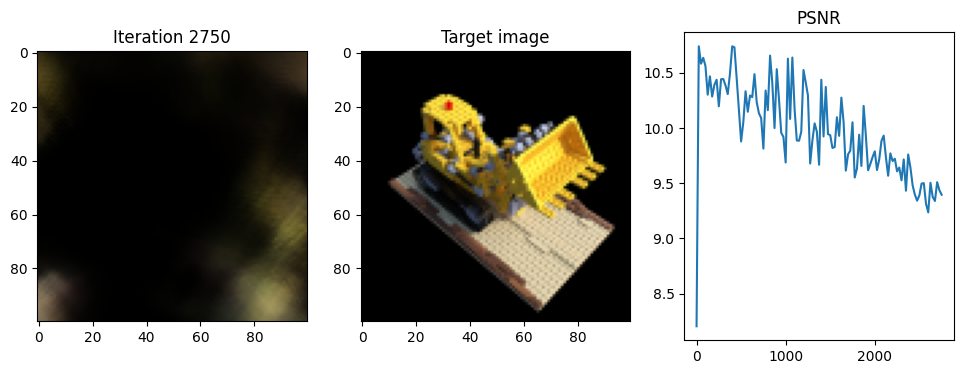

Iteration 2775  Loss: 0.1118  PSNR: 9.52  Time: 0.33 secs per iter,  19.85 mins in total
The rotation error as compared to GT Rotation : 1.0751481676101684


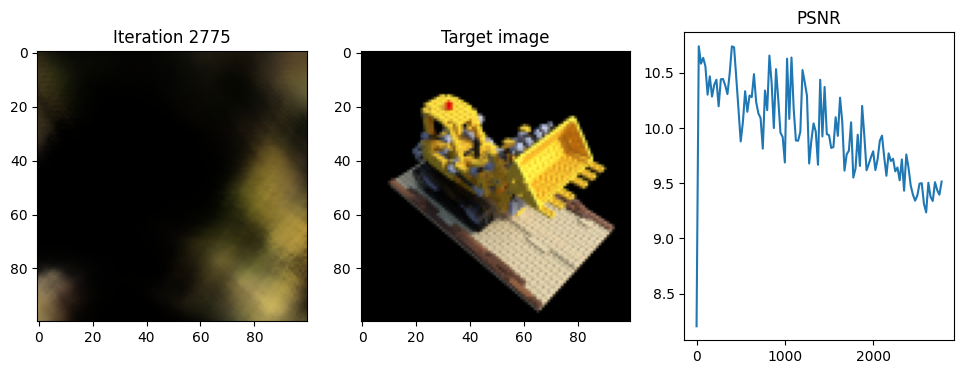

Iteration 2800  Loss: 0.1170  PSNR: 9.32  Time: 0.33 secs per iter,  19.99 mins in total
The rotation error as compared to GT Rotation : 1.0751512622833252


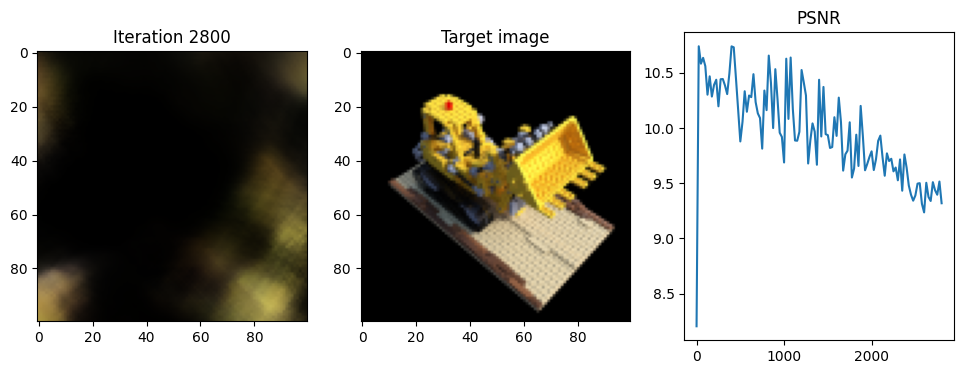

Iteration 2825  Loss: 0.1160  PSNR: 9.36  Time: 0.33 secs per iter,  20.12 mins in total
The rotation error as compared to GT Rotation : 1.0751579952239991


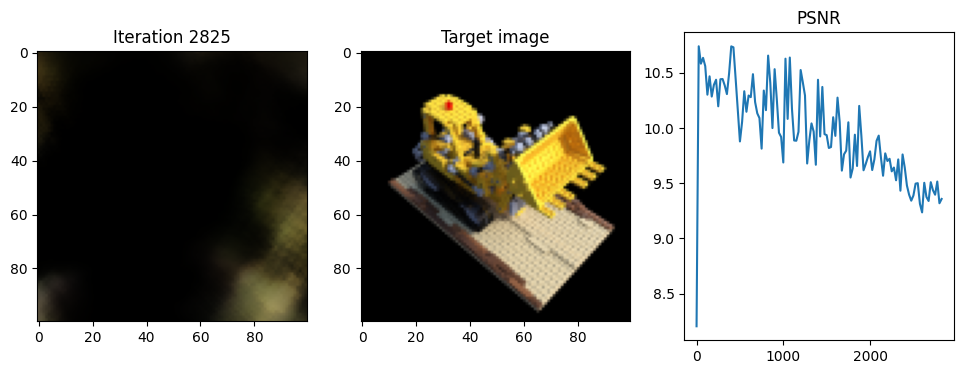

Iteration 2850  Loss: 0.1170  PSNR: 9.32  Time: 0.33 secs per iter,  20.26 mins in total
The rotation error as compared to GT Rotation : 1.0751684713363647


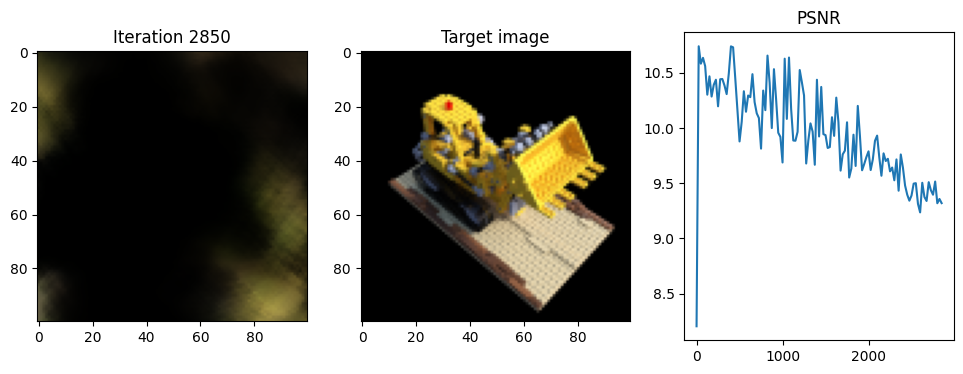

Iteration 2875  Loss: 0.1097  PSNR: 9.60  Time: 0.33 secs per iter,  20.40 mins in total
The rotation error as compared to GT Rotation : 1.075167989730835


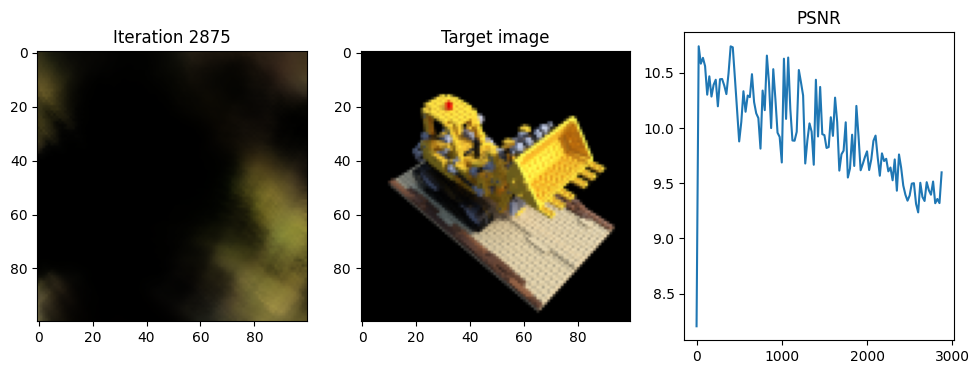

Iteration 2900  Loss: 0.1132  PSNR: 9.46  Time: 0.34 secs per iter,  20.54 mins in total
The rotation error as compared to GT Rotation : 1.0751631546020508


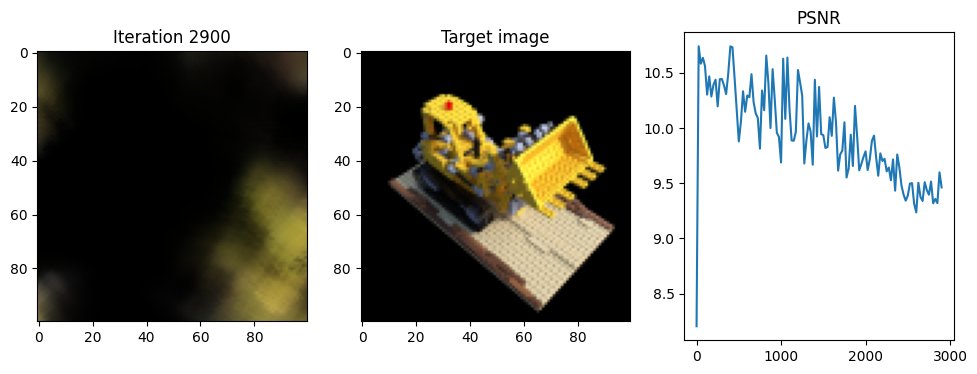

Iteration 2925  Loss: 0.1084  PSNR: 9.65  Time: 0.33 secs per iter,  20.68 mins in total
The rotation error as compared to GT Rotation : 1.0751615858078003


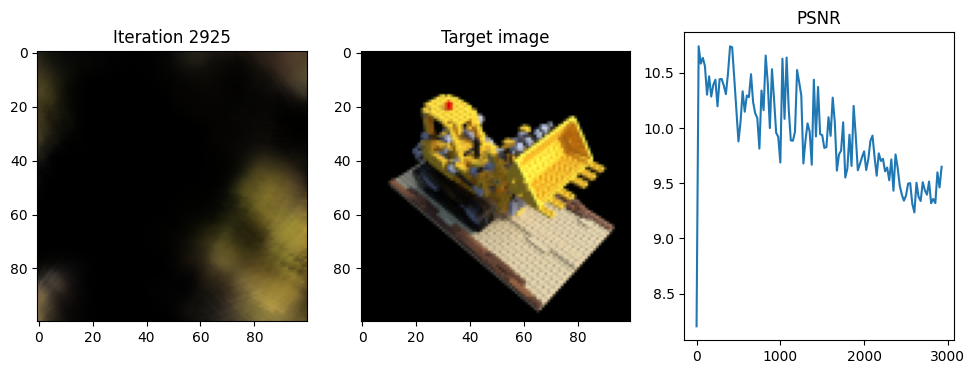

Iteration 2950  Loss: 0.1139  PSNR: 9.43  Time: 0.33 secs per iter,  20.82 mins in total
The rotation error as compared to GT Rotation : 1.0751600694656371


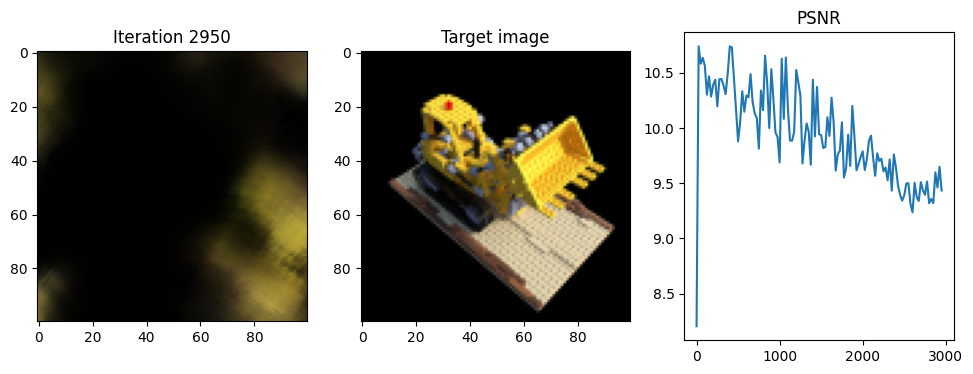

Iteration 2975  Loss: 0.1128  PSNR: 9.48  Time: 0.33 secs per iter,  20.96 mins in total
The rotation error as compared to GT Rotation : 1.075156774520874


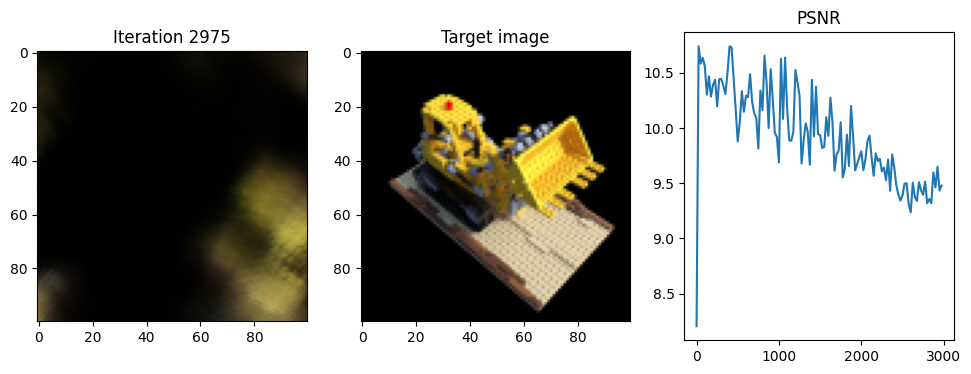

Iteration 3000  Loss: 0.1196  PSNR: 9.22  Time: 0.33 secs per iter,  21.09 mins in total
The rotation error as compared to GT Rotation : 1.0751569271087646


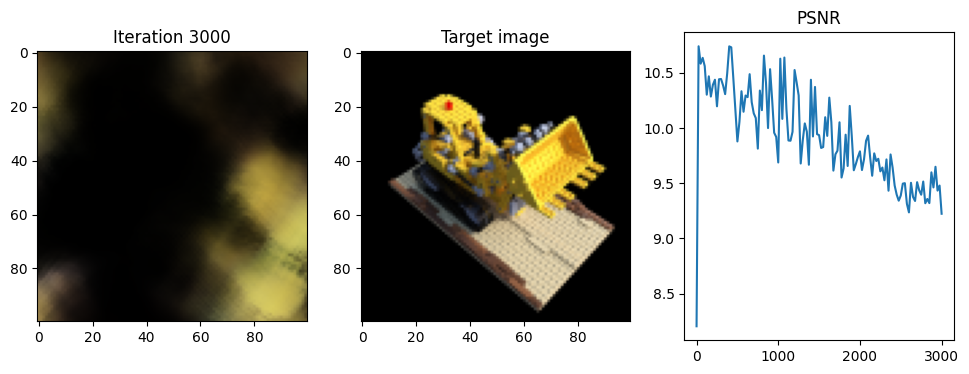

Done!


In [26]:
for i in range(iterations+1):



    
    output_image_idx = np.random.choice(images.shape[0])
    output_image = images[output_image_idx,...]
    
    euler_angles = euler_angles_all[output_image_idx,...].to(device)

    x = euler_angles[0].reshape(1).requires_grad_()
    y = euler_angles[1].reshape(1).requires_grad_()
    z = euler_angles[2].reshape(1).requires_grad_()
    
    tensor_0 = torch.zeros(1).to(device)
    tensor_1 = torch.ones(1).to(device)
    
    Rx = torch.stack([
                torch.stack([tensor_1, tensor_0, tensor_0]),
                torch.stack([tensor_0, torch.cos(x), -torch.sin(x)]),
                torch.stack([tensor_0, torch.sin(x), torch.cos(x)])]).reshape(3,3)
    Ry = torch.stack([
                torch.stack([torch.cos(y), tensor_0, torch.sin(y)]),
                torch.stack([tensor_0, tensor_1, tensor_0]),
                torch.stack([-torch.sin(y), tensor_0, torch.cos(y)])]).reshape(3,3)
    Rz = torch.stack([
                torch.stack([torch.cos(z), -torch.sin(z), tensor_0]),
                torch.stack([torch.sin(z), torch.cos(z), tensor_0]),
                torch.stack([tensor_0, tensor_0, tensor_1])]).reshape(3,3)
    Rx.retain_grad()
    Ry.retain_grad()
    Rz.retain_grad()
    w_R_c = Rz @ Ry @ Rx
    w_R_c = w_R_c.to(device)
    w_T_c = w_T_c_all[output_image_idx,...].to(device)
    
    optimizer.zero_grad()
    rec_image = one_forward_pass(height, width, intrinsics, w_R_c, w_T_c, near, far, samples, model, num_x_frequencies, num_d_frequencies)

    loss = criterion(rec_image, output_image)
    loss.backward()
    

    euler_angles_grad = torch.tensor([x.grad, y.grad, z.grad]).to(device)
    euler_angles_all[output_image_idx,...] = euler_angles - lr_rotation * euler_angles_grad
    
    
    
    
    optimizer.step()
    mse_loss_euler = criterion(euler_angles_all_orig, euler_angles_all)
    running_loss += loss.item()
    psnr = 10 * torch.log10((torch.max(output_image)**2)/loss.item())
    running_psnr += psnr.item()
    running_mse_euler_error += mse_loss_euler.item()

    
    if i % display == 0:
        with torch.no_grad():

            
            test_rec_image = one_forward_pass(height, width, intrinsics, test_pose_w_R_c, test_pose_w_T_c, near, far, samples, model, num_x_frequencies, num_d_frequencies)


            
            loss = criterion(test_rec_image, test_image)
        psnr = 10 * torch.log10((torch.max(test_image)**2)/loss.item())
        
       
  

        
        psnr = 10 * torch.log10((torch.max(test_image)**2)/loss.item())



        print("Iteration %d " % i, "Loss: %.4f " % loss.item(), "PSNR: %.2f " % psnr.item(), \
                "Time: %.2f secs per iter, " % ((time.time() - t) / display), "%.2f mins in total" % ((time.time() - t0)/60))
        if i !=0:
            mse_euler_error_list.append(running_mse_euler_error/display)
            loss_list.append(running_loss/display)
            psnr_list.append(running_psnr/display)
            print('The rotation error as compared to GT Rotation :',running_mse_euler_error/display)
            running_mse_euler_error = 0
            running_loss = 0
            running_psnr = 0
        else:
             print('The rotation error as compared to GT Rotation :',running_mse_euler_error)
        if i%450==0 and i>0 and i<901:
            lr_rotation *= 0.1
        t = time.time()
        psnrs.append(psnr.item())
        iternums.append(i)

        plt.figure(figsize=(16, 4))
        plt.subplot(141)
        plt.imshow(test_rec_image.detach().cpu().numpy())
        plt.title(f"Iteration {i}")
        plt.subplot(142)
        plt.imshow(test_image.detach().cpu().numpy())
        plt.title("Target image")
        plt.subplot(143)
        plt.plot(iternums, psnrs)
        plt.title("PSNR")
        plt.show()

plt.imsave('test_lego_perturb_euler_grad_v2.png',test_rec_image.detach().cpu().numpy())
torch.save(model.state_dict(),'model_perturb_euler_grad_nerf_v2.pt')
print('Done!')

In [27]:
np.save('perturb_euler_grad_loss_list_v2.npy', np.array(loss_list))
np.save('perturb_euler_grad_psnr_list_v2.npy', np.array(psnr_list))
np.save('perturb_euler_grad_mse_euler_list_v2.npy', np.array(mse_euler_error_list)[1:])

In [ ]:
plt.plot(np.array(loss_list))

In [ ]:
plt.plot(np.array(psnr_list))

In [ ]:
plt.plot(np.array(mse_euler_error_list)[1:])

In [ ]:

test_pose_w_R_c = test_pose[:3,:3]
test_pose_w_T_c = test_pose[:3, 3]
lr_rotation=0.1

In [ ]:








r = Rotation.from_matrix(test_pose_w_R_c.cpu())
euler_angles_orig = torch.Tensor(r.as_euler('xyz', degrees = False))
noise = torch.randn_like(euler_angles_orig)
euler_angles = euler_angles_orig + 0.1 * noise

In [ ]:
import copy

In [ ]:

mse_list = []
running_mse = 0
for test_itr in range(1500):
    test_input = copy.deepcopy(euler_angles).to(device)
    test_input.requires_grad_()
    
    x = test_input[0].reshape(1).requires_grad_()
    y = test_input[1].reshape(1).requires_grad_()
    z = test_input[2].reshape(1).requires_grad_()
    
    tensor_0 = torch.zeros(1).to(device)
    tensor_1 = torch.ones(1).to(device)
    
    Rx = torch.stack([
                torch.stack([tensor_1, tensor_0, tensor_0]),
                torch.stack([tensor_0, torch.cos(x), -torch.sin(x)]),
                torch.stack([tensor_0, torch.sin(x), torch.cos(x)])]).reshape(3,3)
    Ry = torch.stack([
                torch.stack([torch.cos(y), tensor_0, torch.sin(y)]),
                torch.stack([tensor_0, tensor_1, tensor_0]),
                torch.stack([-torch.sin(y), tensor_0, torch.cos(y)])]).reshape(3,3)
    Rz = torch.stack([
                torch.stack([torch.cos(z), -torch.sin(z), tensor_0]),
                torch.stack([torch.sin(z), torch.cos(z), tensor_0]),
                torch.stack([tensor_0, tensor_0, tensor_1])]).reshape(3,3)
    Rx.retain_grad()
    Ry.retain_grad()
    Rz.retain_grad()
    w_R_c = Rz @ Ry @ Rx
    w_R_c = w_R_c.to(device)
    
    optimizer.zero_grad()
    rec_image = one_forward_pass(height, width, intrinsics, w_R_c, test_pose_w_T_c.to(device), near, far, samples, model, num_x_frequencies, num_d_frequencies)
    
    loss = criterion(rec_image, test_image)
    loss.backward()
    euler_angles = euler_angles - lr_rotation * test_input.grad.detach().to('cpu')
    mse = criterion(euler_angles.to('cpu'),euler_angles_orig.to('cpu')).detach().item()
    running_mse += mse
    if test_itr%25==0 and test_itr!=0:
        print('Test image MSE is:', running_mse/25)
        mse_list.append(running_mse/25)
        running_mse = 0
    if test_itr==0:
        print('Test image MSE is:', mse)
    if test_itr%150==0 and test_itr>0 and test_itr<601:
            lr_rotation *= 0.01

In [ ]:
plt.plot(mse_list)

In [ ]:
np.save('testpose_perturb_euler_grad_mse_euler_list_v1.npy', np.array(mse_list))

In [ ]:
def plot_all_poses(poses, w_R_c_all_perturb, w_T_c_all):


    poses = torch.Tensor(poses).to(device)
    
    w_R_c = poses[:,:3,:3]
    w_T_c = poses[:,:3,3]
    origins = torch.zeros((poses.shape[0],height, width, 3))
    directions = torch.zeros((poses.shape[0],height, width, 3))
    for i in range(poses.shape[0]):
      ray_o, ray_d = get_rays(height, width, intrinsics, w_R_c[i,...].reshape((3,3)), w_T_c[i,...].reshape((3,1)))
      origins[i] = ray_o.to('cpu')
      directions[i] = ray_d.to('cpu')
      
      
    


    ax = plt.figure(figsize=(12, 8)).add_subplot(projection='3d')
    _ = ax.quiver(origins[..., 0].flatten(),
                  origins[..., 1].flatten(),
                  origins[..., 2].flatten(),
                  directions[..., 0].flatten(),
                  directions[..., 1].flatten(),
                  directions[..., 2].flatten(), length=0.12, normalize=True, color='red')
    
    w_R_c = w_R_c_all_perturb
    w_T_c = w_T_c_all
    origins = torch.zeros((poses.shape[0],height, width, 3))
    directions = torch.zeros((poses.shape[0],height, width, 3))
    for i in range(poses.shape[0]):
      ray_o, ray_d = get_rays(height, width, intrinsics, w_R_c[i,...].reshape((3,3)), w_T_c[i,...].reshape((3,1)))
      origins[i] = ray_o.to('cpu')
      directions[i] = ray_d.to('cpu')
      
      
    


    _ = ax.quiver(origins[..., 0].flatten(),
                  origins[..., 1].flatten(),
                  origins[..., 2].flatten(),
                  directions[..., 0].flatten(),
                  directions[..., 1].flatten(),
                  directions[..., 2].flatten(), length=0.12, normalize=True)
  
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('z')
    plt.show()

plot_all_poses(data['poses'], w_R_c_all_perturb, w_T_c_all)